In [ ]:
#@title
%pip install folium matplotlib mapclassify contextily geopandas seaborn

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 21.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 20.1/20.1 MB 17.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 55.9/55.9 KB 2.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 16.0/16.0 MB 35.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 17.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 96.6/96.6 KB 2.0 MB/s eta 0:00:00
  Attempting uninstall: click
    Found existing installation: click 7.1.2
    Uninstalling click-7.1.2:
      Successfully uninstalled click-7.1.2
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
flask 1.1.4 requires click<8.0,>=5.1, but you have click 8.1.3 which is incompatible.


In [ ]:
#@title
%pip install geopandas

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
#@title
import math

def haversine(coord1, coord2):
    
    # Coordinates in decimal degrees (e.g. 2.89078, 12.79797)
    lon1, lat1 = coord1
    lon2, lat2 = coord2
    R = 6371000  # radius of Earth in meters
    phi_1 = math.radians(lat1)
    phi_2 = math.radians(lat2)

    delta_phi = math.radians(lat2 - lat1)
    delta_lambda = math.radians(lon2 - lon1)

    a = math.sin(delta_phi / 2.0) ** 2 + math.cos(phi_1) * math.cos(phi_2) * math.sin(delta_lambda / 2.0) ** 2

    c = 2 * math.atan2(math.sqrt(a), math.sqrt(1 - a))

    meters = R * c  # output distance in meters
    km = meters / 1000.0  # output distance in kilometers

    return km


In [ ]:
#@title
!ls

sample_data


In [ ]:
#@title
!pip list

Package                       Version
----------------------------- ----------------------
absl-py                       1.4.0
aeppl                         0.0.33
aesara                        2.7.9
affine                        2.4.0
aiohttp                       3.8.3
aiosignal                     1.3.1
alabaster                     0.7.13
albumentations                1.2.1
altair                        4.2.2
appdirs                       1.4.4
arviz                         0.12.1
astor                         0.8.1
astropy                       4.3.1
astunparse                    1.6.3
async-timeout                 4.0.2
atari-py                      0.2.9
atomicwrites                  1.4.1
attrs                         22.2.0
audioread                     3.0.0
autograd                      1.5
Babel                         2.11.0
backcall                      0.2.0
beautifulsoup4                4.6.3
bleach                        6.0.0
blis                          0.7.9
bokeh 

In [ ]:
#@title
import numpy as np

def nearest_neighbor_classification(groupA, groupB, labelsB):
    """
    For each member in group A, finds the nearest member in group B and classifies them based on their nearest neighbor.
    Args:
    groupA (numpy array): 2D array of coordinates for group A
    groupB (numpy array): 2D array of coordinates for group B
    labelsB (numpy array): labels for group B
    Returns:
    numpy array: labels for group A based on nearest neighbor classification
    """
    result = []
    for a in groupA:
        min_distance = np.inf
        nearest_neighbor = None
        for i, b in enumerate(groupB):
            curr_distance = haversine(a, b)
            if curr_distance < min_distance:
                min_distance = curr_distance
                nearest_neighbor = labelsB[i]
        result.append(nearest_neighbor)
    return np.array(result)

This function takes three inputs: groupA and groupB are numpy arrays that represent the coordinates for individuals in groups A and B, respectively. labelsB is a numpy array that contains the labels for group B. The function classifies each individual in group A based on their nearest neighbor in group B, by calculating the Euclidean distance between each pair of individuals. The function returns a numpy array that contains the labels for group A based on nearest neighbor classification.

In [ ]:
#@title
import numpy as np

def nearest_neighbor_distances_by_char_A(groupA, groupB, labelsB, charA):
    """
    Calculates the list of total distance by labels in group B and by characteristics C of each member in group A to the nearest member in group B where C is the characteristics of A.
    Args:
    groupA (numpy array): 2D array of coordinates for group A
    groupB (numpy array): 2D array of coordinates for group B
    labelsB (numpy array): labels for group B
    charA (numpy array): characteristics for group A
    Returns:
    dictionary: mapping of tuples (label in group B, characteristic of A) to total distance for each member in group A
    """
    result = {}
    for i, a in enumerate(groupA):
        min_distance = np.inf
        nearest_neighbor = None
        for j, b in enumerate(groupB):
            curr_distance = haversine(a, b)
            if curr_distance < min_distance:
                min_distance = curr_distance
                nearest_neighbor = labelsB[j]
        key = (nearest_neighbor, charA[i])
        if key not in result:
            result[key] = 0
        result[key] += min_distance
    return result

This function takes four inputs: groupA and groupB are numpy arrays that represent the coordinates for individuals in groups A and B, respectively. labelsB is a numpy array that contains the labels for group B, and charA is a numpy array that contains the characteristics for group A. The function calculates the Euclidean distance between each member in group A and its nearest neighbor in group B, and keeps track of the total distance for each combination of label in group B and characteristic of group A. The function returns a dictionary that maps each tuple of (label in group B, characteristic of A) to its total distance for each member in group A.

In [ ]:
#@title
import numpy as np

def mean_distance_by_char_A(groupA, groupB, charA):
    """
    Calculates the list of mean distance by characteristics C of each member in group A to the nearest member in group B where C is the characteristics of A.
    Args:
    groupA (numpy array): 2D array of coordinates for group A
    groupB (numpy array): 2D array of coordinates for group B
    charA (numpy array): characteristics for group A
    Returns:
    dictionary: mapping of characteristic of A to mean distance for each member in group A
    """
    result = {}
    for i, a in enumerate(groupA):
        min_distance = np.inf
        nearest_neighbor = None
        for j, b in enumerate(groupB):
            curr_distance = a.distance(b)
            print(curr_distance)
            if curr_distance < min_distance:
                min_distance = curr_distance
        key = charA.loc[i]
        if key not in result:
            result[key] = []
        result[key].append(min_distance)
        print(result)
    mean_distances = {char: np.mean(dists) for char, dists in result.items()}
    return mean_distances

# Mean distance optimized

In [ ]:
import pandas as pd
from scipy.stats import f_oneway
from statsmodels.stats.multicomp import pairwise_tukeyhsd

def anova_tukey(df, anova_path= ""):
    # Extract the group labels and values from the DataFrame
    groups = df['race'].unique()
    values = [df[df['race'] == group]['distances'] for group in groups]

    # Perform a one-way ANOVA test
    f_stat, p_val = f_oneway(*values)
    pd.DataFrame({'Fstats': [f_stat],
                  'pval': [p_val]}).to_csv(anova_path+"anova.csv")

    # Perform Tukey's HSD test
    tukey_results = pairwise_tukeyhsd(df['distances'], df['race'])

    # Print the results
    print("One-way ANOVA")
    print("F statistic:", f_stat)
    print("p-value:", p_val)
    print("\nTukey's HSD test")
    print(tukey_results)

    # Return the results as a pandas DataFrame
    results_df = pd.DataFrame(tukey_results.summary().data[1:],
                              columns=tukey_results.summary().data[0])
    results_df.to_csv(anova_path+'tukey.csv')
    return results_df

In [ ]:
def min_max(df, min_max_path= ""):
   
    df[['race','distances']].groupby(['race']).describe().to_csv(min_max_path+"stats_description.csv")


In [ ]:

import geopandas as gpd
def find_nearest_neighbors(groupA, groupB):
    return gpd.sjoin_nearest(groupA, groupB, how="left", distance_col="distances")
def mean_distance_by_char_A_geopandas(groupA, groupB, charA, anova_path= ""):
    """
    Calculates the list of mean distance by characteristics C of each member in group A to the nearest neighbor in group B where C is the characteristics of A.
    Args:
    groupA (geopandas GeoDataFrame): GeoDataFrame for group A
    groupB (geopandas GeoDataFrame): GeoDataFrame for group B
    charA (pandas Series): characteristics for group A
    Returns:
    dictionary: mapping of characteristic of A to mean distance for each member in group A
    """
    sjoin = find_nearest_neighbors(groupA, groupB)
    distances = sjoin.distances
    unique_chars = charA.unique()
    # anova_tukey(sjoin, anova_path)
    min_max(sjoin, anova_path)
    result = {char: distances[charA == char].mean() for char in unique_chars}
    return result

This function takes three inputs: groupA and groupB are numpy arrays that represent the coordinates for individuals in groups A and B, respectively. charA is a numpy array that contains the characteristics for group A. The function calculates the Euclidean distance between each member in group A and its nearest neighbor in group B, and keeps track of the distance for each characteristic of group A. The function returns a dictionary that maps each characteristic of A to its mean distance for each member in group A.

In [ ]:
from google.colab import drive
drive.mount('/content/ggdrive', force_remount=True)

Mounted at /content/ggdrive


In [ ]:
%cd "/content/ggdrive/MyDrive/Bias Project"

/content/ggdrive/MyDrive/Bias Project


In [ ]:
import geopandas as gpd
import pandas as pd

# Resource Locations

## Divvy Station Dataset

In [ ]:
divvy_df = pd.read_csv("./Resource Dataset/Divvy_Bicycle_Stations.csv")

In [ ]:
divvy_df

,ID,Station Name,Total Docks,Docks in Service,Status,Latitude,Longitude,Location
0,1594046383808271024,Troy St & Jackson Blvd,9,9,In Service,41.877505,-87.704850,"(41.877505, -87.70485)"
1,641,Central Park Ave & Bloomingdale Ave,11,11,In Service,41.914166,-87.716755,"(41.914166, -87.716755)"
2,1683527931525155814,Public Rack - Cornell Ave & 87th Pl,1,1,In Service,41.736881,-87.583146,"(41.73688127, -87.58314552)"
3,367,Racine Ave & 35th St,15,15,In Service,41.830689,-87.656211,"(41.83068856472101, -87.65621066093445)"
4,1673852313397164648,Public Rack - Francisco Ave & Touhy Ave,2,2,In Service,42.011865,-87.701317,"(42.011865, -87.701317)"
...,...,...,...,...,...,...,...,...
1414,20,Sheffield Ave & Kingsbury St,15,15,In Service,41.910522,-87.653106,"(41.910522, -87.653106)"
1415,54,Ogden Ave & Chicago Ave,19,19,In Service,41.896362,-87.654061,"(41.896362458, -87.6540612729)"
1416,693,Baltimore Ave & 87th St,15,15,In Service,41.737336,-87.548515,"(41.737335600416664, -87.54851460456847)"
1417,718,Ewing Ave & Burnham Greenway,11,11,In Service,41.712749,-87.534814,"(41.71274876109496, -87.53481388092041)"


In [ ]:
divvy_df_geo = gpd.GeoDataFrame(
    divvy_df[["Station Name","Total Docks","Docks in Service","Status"]], geometry=gpd.points_from_xy(divvy_df.Longitude, divvy_df.Latitude)
).set_crs('epsg:4326').to_crs('epsg:26916')

In [ ]:
divvy_df_geo

,Station Name,Total Docks,Docks in Service,Status,geometry
0,Troy St & Jackson Blvd,9,9,In Service,POINT (441514.016 4636416.042)
1,Central Park Ave & Bloomingdale Ave,11,11,In Service,POINT (440560.180 4640494.613)
2,Public Rack - Cornell Ave & 87th Pl,1,1,In Service,POINT (451506.737 4620727.411)
3,Racine Ave & 35th St,15,15,In Service,POINT (445510.235 4631186.160)
4,Public Rack - Francisco Ave & Touhy Ave,2,2,In Service,POINT (441929.231 4651331.454)
...,...,...,...,...,...
1414,Sheffield Ave & Kingsbury St,15,15,In Service,POINT (445835.478 4640047.874)
1415,Ogden Ave & Chicago Ave,19,19,In Service,POINT (445744.266 4638476.375)
1416,Baltimore Ave & 87th St,15,15,In Service,POINT (454386.909 4620758.919)
1417,Ewing Ave & Burnham Greenway,11,11,In Service,POINT (455509.272 4618022.017)


## L Stops Dataset

In [ ]:
L_train_df = pd.read_csv("./Resource Dataset/CTA_-_System_Information_-_List_of__L__Stops.csv")

In [ ]:
L_train_df

,STOP_ID,DIRECTION_ID,STOP_NAME,STATION_NAME,STATION_DESCRIPTIVE_NAME,MAP_ID,ADA,RED,BLUE,G,BRN,P,Pexp,Y,Pnk,O,Location
0,30082,E,Cicero (Loop-bound),Cicero,Cicero (Pink Line),40420,True,False,False,False,False,False,False,False,True,False,"(41.85182, -87.745336)"
1,30151,E,Central Park (Loop-bound),Central Park,Central Park (Pink Line),40780,True,False,False,False,False,False,False,False,True,False,"(41.853839, -87.714842)"
2,30184,W,Halsted/63rd (Ashland-bound),Halsted,Halsted (Green Line),40940,True,False,False,True,False,False,False,False,False,False,"(41.778943, -87.644244)"
3,30044,N,Cumberland (O'Hare-bound),Cumberland,Cumberland (Blue Line),40230,True,False,True,False,False,False,False,False,False,False,"(41.984246, -87.838028)"
4,30092,E,Racine (O'Hare-bound),Racine,Racine (Blue Line),40470,False,False,True,False,False,False,False,False,False,False,"(41.87592, -87.659458)"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
295,30009,W,Cicero (Harlem-bound),Cicero,Cicero (Green Line),40480,True,False,False,True,False,False,False,False,False,False,"(41.886519, -87.744698)"
296,30259,N,Montrose (O'Hare-bound),Montrose,Montrose (Blue Line),41330,False,False,True,False,False,False,False,False,False,False,"(41.961539, -87.743574)"
297,30125,N,North/Clybourn (Howard-bound),North/Clybourn,North/Clybourn (Red Line),40650,False,True,False,False,False,False,False,False,False,False,"(41.910655, -87.649177)"
298,30172,S,O'Hare (Forest Pk-bound),O'Hare,O'Hare (Blue Line),40890,True,False,True,False,False,False,False,False,False,False,"(41.97766526, -87.90422307)"


In [ ]:
def extract_string(text, start_char, end_char):
    start_index = text.find(start_char)
    end_index = text.find(end_char)
    if start_index != -1 and end_index != -1:
        return text[start_index + 1:end_index]
    return None
L_train_df.Location = L_train_df.Location.map(lambda x: 'POINT (' + extract_string(x, ",", ")") + " " +extract_string(x, "(", ",")+ ")")

In [ ]:
L_train_df_geo = gpd.GeoDataFrame(
    L_train_df[['STOP_ID',	'DIRECTION_ID',	'STOP_NAME',	'STATION_NAME',	'STATION_DESCRIPTIVE_NAME'	]], geometry=gpd.GeoSeries.from_wkt(L_train_df.Location),
).set_crs('epsg:4326').to_crs('epsg:26916')

In [ ]:
L_train_df_geo

,STOP_ID,DIRECTION_ID,STOP_NAME,STATION_NAME,STATION_DESCRIPTIVE_NAME,geometry
0,30082,E,Cicero (Loop-bound),Cicero,Cicero (Pink Line),POINT (438129.851 4633592.688)
1,30151,E,Central Park (Loop-bound),Central Park,Central Park (Pink Line),POINT (440663.031 4633795.329)
2,30184,W,Halsted/63rd (Ashland-bound),Halsted,Halsted (Green Line),POINT (446460.853 4625433.543)
3,30044,N,Cumberland (O'Hare-bound),Cumberland,Cumberland (Blue Line),POINT (430579.133 4648366.696)
4,30092,E,Racine (O'Hare-bound),Racine,Racine (Blue Line),POINT (445279.153 4636210.128)
...,...,...,...,...,...,...
295,30009,W,Cicero (Harlem-bound),Cicero,Cicero (Green Line),POINT (438216.233 4637444.767)
296,30259,N,Montrose (O'Hare-bound),Montrose,Montrose (Blue Line),POINT (438381.715 4645773.309)
297,30125,N,North/Clybourn (Howard-bound),North/Clybourn,North/Clybourn (Red Line),POINT (446161.438 4640060.167)
298,30172,S,O'Hare (Forest Pk-bound),O'Hare,O'Hare (Blue Line),POINT (425087.882 4647691.811)


## Bus stop dataset

In [ ]:
bus_df_geo = gpd.read_file
import geopandas as gpd
import fiona
from zipfile import ZipFile

# kmz = ZipFile('./Resource Dataset/CTA_BusStops.kmz', 'r')
# kmz.extractall(path='./Resource Dataset/')
fiona.drvsupport.supported_drivers['KML'] = 'rw'
bus_df_geo = gpd.read_file('./Resource Dataset/doc.kml', driver='KML')

In [ ]:
bus_df_geo = bus_df_geo.set_crs('epsg:4326').to_crs('epsg:26916')

In [ ]:
bus_df_geo

,Name,Description,geometry
0,East River Rd & Berwyn,"<html xmlns:fo=""http://www.w3.org/1999/XSL/For...",POINT Z (429874.733 4647331.952 0.000)
1,Cumberland Blue Line Station,"<html xmlns:fo=""http://www.w3.org/1999/XSL/For...",POINT Z (430495.694 4648304.613 0.000)
2,Lawrence & Cumberland,"<html xmlns:fo=""http://www.w3.org/1999/XSL/For...",POINT Z (430692.241 4646417.262 0.000)
3,Cumberland & Foster,"<html xmlns:fo=""http://www.w3.org/1999/XSL/For...",POINT Z (430666.485 4647208.136 0.000)
4,Cumberland & Berwyn,"<html xmlns:fo=""http://www.w3.org/1999/XSL/For...",POINT Z (430692.937 4647405.307 0.000)
...,...,...,...
10817,Ewing & 106th Street,"<html xmlns:fo=""http://www.w3.org/1999/XSL/For...",POINT Z (455470.963 4616937.665 0.000)
10818,Ewing & 101st Street,"<html xmlns:fo=""http://www.w3.org/1999/XSL/For...",POINT Z (455480.963 4617928.549 0.000)
10819,Avenue C & 112th Street,"<html xmlns:fo=""http://www.w3.org/1999/XSL/For...",POINT Z (456136.469 4615705.085 0.000)
10820,Avenue C & 110th Street,"<html xmlns:fo=""http://www.w3.org/1999/XSL/For...",POINT Z (456141.172 4616103.995 0.000)


## Hospital

In [ ]:
hospital_df = pd.read_csv("./Resource Dataset/HospitalPoint.csv")

In [ ]:
hospital_df

,the_geom,CFNAME,CFTYPE,CFSUBTYPE,ADDRESS,GNISCODE,COMMENT,SOURCE,Jurisdicti,Community,MERGEID
0,POINT (-87.73243810773631 41.7222018708637),Advocate Christ Medical Center,Hospital,Hospital,9340 S Kostner Ave,426825,NaN,CGI,NaN,Oak Lawn,11216
1,POINT (-87.86555195157536 41.61053339574968),Palos Primary Care Center,Hospital,Hospital,15300 West Ave,2036658,NaN,CL,NaN,Orland Park,11376
2,POINT (-87.73148565258943 41.59966681935893),Oak Forest Hospital,Hospital,Hospital,15901 Cicero Ave,414760,NaN,CEGL,NaN,Bremen Twp,11469
3,POINT (-87.84346546209689 41.91077939659816),Gottlieb Memorial Hospital,Hospital,Hospital,375 W North Ave,409212,NaN,BCEG,NaN,Melrose Park,12387
4,POINT (-87.8516148467434 42.092629838665076),Glenbrook Hospital,Hospital,Hospital,2100 Pfingsten Rd,2033578,NaN,CEGI,NaN,Glenview,12751
...,...,...,...,...,...,...,...,...,...,...,...
88,POINT (-87.44865797781168 41.6350272917085),St Catherine Hospital,Hospital,Hospital,4321 Fir St,0,NaN,E,NaN,East Chicago,25973
89,POINT (-87.5235846231666 41.61487807082655),Franciscan St Margaret Health,Hospital,Hospital,5454 Hohman Ave,0,NaN,E,NaN,Hammond,25974
90,POINT (-88.0571552013984 41.91487715481491),Adventist GlenOaks Hospital,Hospital,Hospital,701 Winthrop Ave,0,NaN,E,NaN,Glendale Heights,25982
91,POINT (-87.80762061941424 42.19056640060012),NorthShore University HealthSystem Highland Pa...,Hospital,Hospital,777 Park Avenue West,0,NaN,E,NaN,Highland Park,25983


In [ ]:
def extract_string(text, start_char, end_char):
    start_index = text.find(start_char)
    end_index = text.find(end_char)
    if start_index != -1 and end_index != -1:
        return text[start_index + 1:end_index]
    return None


In [ ]:
hospital_df_geo = gpd.GeoDataFrame(
    hospital_df[['CFNAME', 	'CFTYPE'	]], geometry=gpd.GeoSeries.from_wkt(hospital_df.the_geom),
).set_crs('epsg:4326').to_crs('epsg:26916')

In [ ]:
hospital_df_geo

,CFNAME,CFTYPE,geometry
0,Advocate Christ Medical Center,Hospital,POINT (439077.913 4619192.525)
1,Palos Primary Care Center,Hospital,POINT (427881.278 4606897.421)
2,Oak Forest Hospital,Hospital,POINT (439041.679 4605587.599)
3,Gottlieb Memorial Hospital,Hospital,POINT (430048.426 4640214.184)
4,Glenbrook Hospital,Hospital,POINT (429573.395 4660411.753)
...,...,...,...
88,St Catherine Hospital,Hospital,POINT (462631.603 4609352.221)
89,Franciscan St Margaret Health,Hospital,POINT (456377.418 4607150.390)
90,Adventist GlenOaks Hospital,Hospital,POINT (412331.790 4640865.519)
91,NorthShore University HealthSystem Highland Pa...,Hospital,POINT (433314.494 4671250.600)


## Schools

In [ ]:
schools_df = pd.read_csv("./Resource Dataset/schools.csv", index_col=0)

In [ ]:
schools_df

,the_geom,School_ID,Short_Name,Address,Grade_Cat,Lat,Long,Comm_Area
0,POINT (-87.6266211792559 41.81924917367548),610590,BRONZEVILLE CLASSICAL,8 W ROOT ST,ES,41.819249,-87.626621,38
1,POINT (-87.64556149971644 41.907796795867235),400113,CICS - CHICAGOQUEST HS,1443 N OGDEN AVE,HS,41.907797,-87.645561,8
2,POINT (-87.55990690211836 41.74267138259229),400168,GREAT LAKES,8401 S SAGINAW AVE,ES,41.742671,-87.559907,46
3,POINT (-87.63756486350432 41.91389953306062),610033,LASALLE,1734 N ORLEANS ST,ES,41.913900,-87.637565,7
4,POINT (-87.73599882158203 41.92791840313385),609716,KELVYN PARK HS,4343 W WRIGHTWOOD AVE,HS,41.927918,-87.735999,20
...,...,...,...,...,...,...,...,...
645,POINT (-87.75892840072247 41.79904639800406),610206,TWAIN,5134 S LOTUS AVE,ES,41.799046,-87.758928,56
646,POINT (-87.71954054421472 41.94109399066556),610144,REILLY,3650 W SCHOOL ST,ES,41.941094,-87.719541,21
647,POINT (-87.65250013919314 41.719291947815584),610032,GREEN,1150 W 96TH ST,ES,41.719292,-87.652500,73
648,POINT (-87.65097986936044 41.95280951201589),609850,GREELEY,832 W SHERIDAN RD,ES,41.952810,-87.650980,6


In [ ]:
schools_df_geo = gpd.GeoDataFrame(
    schools_df[['Short_Name', 	'Address'	]], geometry=gpd.GeoSeries.from_wkt(schools_df.the_geom),
).set_crs('epsg:4326').to_crs('epsg:26916')

In [ ]:
schools_df_geo

,Short_Name,Address,geometry
0,BRONZEVILLE CLASSICAL,8 W ROOT ST,POINT (447958.005 4629897.743)
1,CICS - CHICAGOQUEST HS,1443 N OGDEN AVE,POINT (446458.897 4639740.563)
2,GREAT LAKES,8401 S SAGINAW AVE,POINT (453443.405 4621357.422)
3,LASALLE,1734 N ORLEANS ST,POINT (447127.156 4640413.177)
4,KELVYN PARK HS,4343 W WRIGHTWOOD AVE,POINT (438977.404 4642035.035)
...,...,...,...
645,TWAIN,5134 S LOTUS AVE,POINT (436949.783 4627743.299)
646,REILLY,3650 W SCHOOL ST,POINT (440354.266 4643486.319)
647,GREEN,1150 W 96TH ST,POINT (445724.509 4618815.969)
648,GREELEY,832 W SHERIDAN RD,POINT (446047.455 4644741.644)


## Illinois boundary

In [ ]:
boundary = gpd.read_file("./Boundary/Boundaries - Neighborhoods.geojson").to_crs('epsg:26916')

In [ ]:
boundary

,pri_neigh,sec_neigh,shape_area,shape_len,geometry
0,Grand Boulevard,BRONZEVILLE,48492503.1554,28196.837157,"MULTIPOLYGON (((449609.917 4629615.480, 449610..."
1,Printers Row,PRINTERS ROW,2162137.97139,6864.247156,"MULTIPOLYGON (((447920.858 4636018.328, 447921..."
2,United Center,UNITED CENTER,32520512.7053,23101.363745,"MULTIPOLYGON (((444658.786 4637650.801, 444658..."
3,Sheffield & DePaul,SHEFFIELD & DEPAUL,10482592.2987,13227.049745,"MULTIPOLYGON (((445411.313 4641287.979, 445410..."
4,Humboldt Park,HUMBOLDT PARK,125010425.593,46126.751351,"MULTIPOLYGON (((438557.834 4637586.620, 438557..."
...,...,...,...,...,...
93,Belmont Cragin,"BELMONT CRAGIN,HERMOSA",109099407.211,43311.706886,"MULTIPOLYGON (((438516.599 4640824.978, 438517..."
94,Austin,AUSTIN,170037750.826,55473.345911,"MULTIPOLYGON (((437290.701 4640667.430, 437316..."
95,Gold Coast,GOLD COAST,7165705.53467,13685.479377,"MULTIPOLYGON (((448046.266 4640136.702, 448050..."
96,Boystown,BOYSTOWN,3365778.97115,9780.268985,"MULTIPOLYGON (((446218.613 4643316.659, 446178..."


# Synthetic dataset

## Merge dataset

In [ ]:
def merge_dataset(df: pd.DataFrame, list_grouped= ['P1_009N']):
    dict_merge={
        'P1_002N': ['P1_003N', 'P1_004N','P1_005N', 'P1_006N', 'P1_007N', 'P1_008N'],
        'P1_009N': ['P1_011N','P1_012N','P1_013N','P1_014N','P1_015N','P1_016N',
                    'P1_017N','P1_018N','P1_019N','P1_020N','P1_021N','P1_022N',
                    'P1_023N','P1_024N','P1_025N', 'P1_027N', 'P1_028N', 'P1_029N', 'P1_030N',
                'P1_031N', 'P1_032N', 'P1_033N', 'P1_034N', 'P1_035N',
                'P1_036N', 'P1_037N', 'P1_038N', 'P1_039N', 'P1_040N',
                'P1_041N', 'P1_042N', 'P1_043N', 'P1_044N', 'P1_045N',
                'P1_046N', 'P1_048N', 'P1_049N', 'P1_050N', 'P1_051N',
                'P1_052N', 'P1_053N', 'P1_054N', 'P1_055N', 'P1_056N',
                'P1_057N', 'P1_058N', 'P1_059N', 'P1_060N', 'P1_061N',
                'P1_062N', 'P1_063N', 'P1_064N', 'P1_065N', 'P1_066N',
                'P1_067N', 'P1_068N', 'P1_069N', 'P1_071N'],
        'P1_010N': ['P1_011N','P1_012N','P1_013N','P1_014N','P1_015N','P1_016N',
                    'P1_017N','P1_018N','P1_019N','P1_020N','P1_021N','P1_022N',
                    'P1_023N','P1_024N','P1_025N'],
        'P1_026N': ['P1_027N', 'P1_028N', 'P1_029N', 'P1_030N',
                'P1_031N', 'P1_032N', 'P1_033N', 'P1_034N', 'P1_035N',
                'P1_036N', 'P1_037N', 'P1_038N', 'P1_039N', 'P1_040N',
                'P1_041N', 'P1_042N', 'P1_043N', 'P1_044N', 'P1_045N',
                'P1_046N'],
        'P1_047N': [ 'P1_048N', 'P1_049N', 'P1_050N', 'P1_051N',
                'P1_052N', 'P1_053N', 'P1_054N', 'P1_055N', 'P1_056N',
                'P1_057N', 'P1_058N', 'P1_059N', 'P1_060N', 'P1_061N',
                'P1_062N', 'P1_063N', 'P1_064N', 'P1_065N', 'P1_066N',
                'P1_067N', 'P1_068N', 'P1_069N'],
        'P1_008N': ['P1_005N', 'P1_007N', 'P1_008N']

    }
    for label in list_grouped: 
      df['race'] = df['race'].replace(dict_merge[label],label) 
    
    return df

## 200 thousand people dataset

In [ ]:
synthetic_dataset = pd.read_csv("./Synthetic Dataset/IL_dataset_200thousand.csv")

In [ ]:
synthetic_dataset


,Unnamed: 0,FIPS,race,lon,lat
0,0,170010001001000,P1_003N,-91.336085,39.967081
1,0,170010001001007,P1_003N,-91.372141,39.962225
2,0,170010001001008,P1_003N,-91.370330,39.961106
3,0,170010001001009,P1_004N,-91.371008,39.960377
4,0,170010001001016,P1_003N,-91.371107,39.958578
...,...,...,...,...,...
199995,0,172030307003188,P1_003N,-89.019209,40.736792
199996,0,172030307003200,P1_003N,-89.020680,40.735391
199997,0,172030307003202,P1_003N,-89.022316,40.736310
199998,0,172030307003205,P1_003N,-89.023415,40.734067


In [ ]:
synthetic_dataset_geo_200thousand = gpd.GeoDataFrame(
    synthetic_dataset[["FIPS","race"]], geometry=gpd.points_from_xy(synthetic_dataset.lon, synthetic_dataset.lat)
).set_crs('epsg:4326').to_crs('epsg:26916')

In [ ]:
Chicago_df = gpd.sjoin(synthetic_dataset_geo_200thousand, boundary, how="inner", op='intersects')

/usr/local/lib/python3.8/dist-packages/IPython/core/interactiveshell.py:3249: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  if (await self.run_code(code, result,  async_=asy)):


In [ ]:
Chicago_df = Chicago_df.drop(columns=["shape_area", "shape_len", "index_right"])

In [ ]:
Chicago_df

,FIPS,race,geometry,pri_neigh,sec_neigh
8780,170310101001000,P1_003N,POINT (-9759039.763 5164356.296),Rogers Park,ROGERS PARK
8781,170310101001000,P1_003N,POINT (-9759086.452 5164318.764),Rogers Park,ROGERS PARK
8782,170310101001002,P1_003N,POINT (-9759275.293 5164210.320),Rogers Park,ROGERS PARK
8783,170310101001002,P1_003N,POINT (-9759347.421 5164201.771),Rogers Park,ROGERS PARK
8784,170310101001002,P1_004N,POINT (-9759437.000 5164176.888),Rogers Park,ROGERS PARK
...,...,...,...,...,...
89986,170318411004012,P1_006N,POINT (-9755198.186 5138856.317),Chinatown,"ARMOUR SQUARE,CHINATOWN"
89987,170318411004012,P1_006N,POINT (-9755291.751 5138791.560),Chinatown,"ARMOUR SQUARE,CHINATOWN"
89988,170318411004012,P1_006N,POINT (-9755163.133 5138772.333),Chinatown,"ARMOUR SQUARE,CHINATOWN"
89989,170318411004013,P1_006N,POINT (-9755202.675 5138698.951),Chinatown,"ARMOUR SQUARE,CHINATOWN"


### Find mean distance nearest neighbors from group A to group B by race


In [ ]:
results_200thousands = mean_distance_by_char_A_geopandas(Chicago_df, divvy_df_geo, Chicago_df["race"])

In [ ]:
results_200thousands

{'P1_003N': 813.5047965181915,
 'P1_004N': 431.8097438027748,
 'P1_008N': 600.4841376131671,
 'P1_019N': 488.1052056375446,
 'P1_006N': 543.2480159963525,
 'P1_015N': 706.4997441641652,
 'P1_033N': 603.8915186851747,
 'P1_017N': 428.1923163508332,
 'P1_014N': 728.0816704017079,
 'P1_007N': 346.9319967937816,
 'P1_023N': 188.31268853558416,
 'P1_013N': 646.7270021698408,
 'P1_011N': 478.96540253414014,
 'P1_027N': 422.3927590690421,
 'P1_012N': 756.6527337160458,
 'P1_016N': 508.03249739719195,
 'P1_005N': 630.2499608714668,
 'P1_052N': 485.97539950035264,
 'P1_030N': 966.8110303322853,
 'P1_050N': 685.0991084608763,
 'P1_022N': 628.0156631875464,
 'P1_024N': 399.9042728818975,
 'P1_041N': 402.21972051351594,
 'P1_049N': 550.4926335481997,
 'P1_035N': 392.6839829556268,
 'P1_020N': 369.32826037787845,
 'P1_031N': 246.806347379903,
 'P1_025N': 503.8962539752364,
 'P1_034N': 320.71659713280303,
 'P1_055N': 322.6656476533542,
 'P1_064N': 817.7422908724993,
 'P1_039N': 1252.3744368510283,
 

In [ ]:
newdf = pd.Series(results_200thousands)

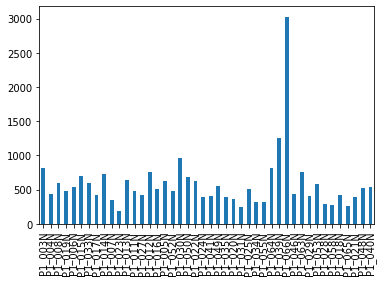

In [ ]:
newdf.plot.bar()

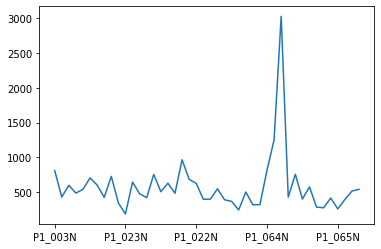

In [ ]:
newdf.plot()

## Test with 10 million people

In [ ]:
import geopandas as gpd
import pandas as pd

In [ ]:
synthetic_dataset = pd.read_csv("./Synthetic Dataset/IL_dataset_10mil.csv")

In [ ]:
synthetic_dataset_geo_10mil = gpd.GeoDataFrame(
    synthetic_dataset[["FIPS","race"]], geometry=gpd.points_from_xy(synthetic_dataset.lon, synthetic_dataset.lat)).set_crs('epsg:4326').to_crs('epsg:26916')


In [ ]:
synthetic_dataset_geo_10mil

,FIPS,race,geometry
0,170010001001000,P1_003N,POINT (130073.947 4433235.322)
1,170010001001000,P1_003N,POINT (129522.917 4433284.814)
2,170010001001000,P1_003N,POINT (128193.253 4432980.506)
3,170010001001000,P1_003N,POINT (129408.524 4433271.280)
4,170010001001000,P1_003N,POINT (130128.433 4433195.327)
...,...,...,...
12812503,172030307003231,P1_003N,POINT (335021.549 4513315.962)
12812504,172030307003231,P1_003N,POINT (334968.109 4513244.816)
12812505,172030307003231,P1_003N,POINT (334825.565 4513585.619)
12812506,172030307003231,P1_003N,POINT (334974.207 4513952.388)


In [ ]:
Chicago_df = gpd.sjoin(synthetic_dataset_geo_10mil, boundary, how="inner", op='intersects')

/usr/local/lib/python3.8/dist-packages/IPython/core/interactiveshell.py:3249: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  if (await self.run_code(code, result,  async_=asy)):


In [ ]:
Chicago_df = Chicago_df.drop(columns=["shape_area", "shape_len", "index_right"])

In [ ]:
Chicago_df=Chicago_df.reset_index(drop=True)

### Find nearest neighbors from group A to group B




In [ ]:
schools_df_geo

,Short_Name,Address,geometry
0,BRONZEVILLE CLASSICAL,8 W ROOT ST,POINT (447958.005 4629897.743)
1,CICS - CHICAGOQUEST HS,1443 N OGDEN AVE,POINT (446458.897 4639740.563)
2,GREAT LAKES,8401 S SAGINAW AVE,POINT (453443.405 4621357.422)
3,LASALLE,1734 N ORLEANS ST,POINT (447127.156 4640413.177)
4,KELVYN PARK HS,4343 W WRIGHTWOOD AVE,POINT (438977.404 4642035.035)
...,...,...,...
645,TWAIN,5134 S LOTUS AVE,POINT (436949.783 4627743.299)
646,REILLY,3650 W SCHOOL ST,POINT (440354.266 4643486.319)
647,GREEN,1150 W 96TH ST,POINT (445724.509 4618815.969)
648,GREELEY,832 W SHERIDAN RD,POINT (446047.455 4644741.644)


In [ ]:
neighbors_df = find_nearest_neighbors(Chicago_df, divvy_df_geo)

In [ ]:
from shapely import Point
distance_geo_df = neighbors_df
neighbors_df['current_loc'] = neighbors_df['geometry']
neighbors_df['resource_loc'] = neighbors_df['index_right'].apply(lambda index: schools_df_geo.loc[index, 'geometry'])

In [ ]:
neighbors_df

,FIPS,race,geometry,pri_neigh,sec_neigh,index_right,Short_Name,Address,distances,current_loc,resource_loc
0,170310101001000,P1_003N,POINT (444779.716 4652467.780),Rogers Park,ROGERS PARK,131,GALE,1631 W JONQUIL TER,430.445134,POINT (444779.716 4652467.780),POINT (444369.856802765 4652336.256157812)
1,170310101001000,P1_003N,POINT (444811.297 4652533.761),Rogers Park,ROGERS PARK,131,GALE,1631 W JONQUIL TER,483.609134,POINT (444811.297 4652533.761),POINT (444369.856802765 4652336.256157812)
2,170310101001000,P1_003N,POINT (444645.640 4652542.501),Rogers Park,ROGERS PARK,131,GALE,1631 W JONQUIL TER,344.373829,POINT (444645.640 4652542.501),POINT (444369.856802765 4652336.256157812)
3,170310101001000,P1_003N,POINT (444737.459 4652514.861),Rogers Park,ROGERS PARK,131,GALE,1631 W JONQUIL TER,408.694549,POINT (444737.459 4652514.861),POINT (444369.856802765 4652336.256157812)
4,170310101001000,P1_003N,POINT (444831.268 4652512.753),Rogers Park,ROGERS PARK,131,GALE,1631 W JONQUIL TER,494.015684,POINT (444831.268 4652512.753),POINT (444369.856802765 4652336.256157812)
...,...,...,...,...,...,...,...,...,...,...,...
2745116,170318390004006,P1_012N,POINT (447869.192 4635872.693),Printers Row,PRINTERS ROW,540,JONES HS,700 S STATE ST,44.941662,POINT (447869.192 4635872.693),POINT (447914.1266911165 4635873.473073839)
2745117,170318390004006,P1_015N,POINT (447855.639 4635871.858),Printers Row,PRINTERS ROW,540,JONES HS,700 S STATE ST,58.510389,POINT (447855.639 4635871.858),POINT (447914.1266911165 4635873.473073839)
2745118,170318390004006,P1_006N,POINT (447862.304 4635791.194),Printers Row,PRINTERS ROW,540,JONES HS,700 S STATE ST,97.238964,POINT (447862.304 4635791.194),POINT (447914.1266911165 4635873.473073839)
2745119,170318390004006,P1_006N,POINT (447852.006 4635878.230),Printers Row,PRINTERS ROW,540,JONES HS,700 S STATE ST,62.302179,POINT (447852.006 4635878.230),POINT (447914.1266911165 4635873.473073839)


In [ ]:
from shapely.geometry import LineString
from shapely import wkt

neighbors_df['geometry'] = neighbors_df.apply(lambda row: LineString([row['current_loc'], row['resource_loc']]).wkt, axis = 1).apply(wkt.loads)

In [ ]:
neighbors_df = merge_dataset(neighbors_df, list_grouped=['P1_009N', 'P1_008N'])

In [ ]:
neighbors_df

In [ ]:
import seaborn as sns
sns.color_palette()

In [ ]:
import matplotlib.colors as mcolors
from random import sample
races = neighbors_df['race'].unique().tolist()
colors = dict(zip(races, list(sns.color_palette())[:len(races)]))

In [ ]:
#@title
import math

from matplotlib.patches import Rectangle
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors


def plot_colortable(colors, *, ncols=4, sort_colors=True):

    cell_width = 212
    cell_height = 22
    swatch_width = 48
    margin = 12

    # Sort colors by hue, saturation, value and name.
    if sort_colors is True:
        names = sorted(colors)
    else:
        names = list(colors)

    n = len(names)
    nrows = math.ceil(n / ncols)

    width = cell_width * 4 + 2 * margin
    height = cell_height * nrows + 2 * margin
    dpi = 72

    fig, ax = plt.subplots(figsize=(width / dpi, height / dpi), dpi=dpi)
    fig.subplots_adjust(margin/width, margin/height,
                        (width-margin)/width, (height-margin)/height)
    ax.set_xlim(0, cell_width * 4)
    ax.set_ylim(cell_height * (nrows-0.5), -cell_height/2.)
    ax.yaxis.set_visible(False)
    ax.xaxis.set_visible(False)
    ax.set_axis_off()

    for i, name in enumerate(names):
        row = i % nrows
        col = i // nrows
        y = row * cell_height

        swatch_start_x = cell_width * col
        text_pos_x = cell_width * col + swatch_width + 7

        ax.text(text_pos_x, y, name, fontsize=14,
                horizontalalignment='left',
                verticalalignment='center')

        ax.add_patch(
            Rectangle(xy=(swatch_start_x, y-9), width=swatch_width,
                      height=18, facecolor=colors[name], edgecolor='0.7')
        )

    return fig

In [ ]:
#@title
# attributes = pd.read_csv('./Boundary/attribute.csv', sep='\t', header=None, index_col=False)

In [ ]:
#@title
# attributes_series = attributes[1]
# attributes_series.index = attributes[0]
attributes_series
attributes_series = {'P1_003N':'White',
                     'P1_004N':'Black',
                     'P1_006N':'Asian',
                    'P1_008N': 'Other Races',
                   'P1_009N':'Mixed Races'}

0
P1_001N                                               Total:
P1_002N                              Population of one race:
P1_003N                                          White alone
P1_004N                      Black or African American alone
P1_005N              American Indian and Alaska Native alone
                                 ...                        
P1_067N    White; Black or African American; Asian; Nativ...
P1_068N    White; American Indian and Alaska Native; Asia...
P1_069N    Black or African American; American Indian and...
P1_070N                             Population of six races:
P1_071N    White; Black or African American; American Ind...
Name: 1, Length: 71, dtype: object

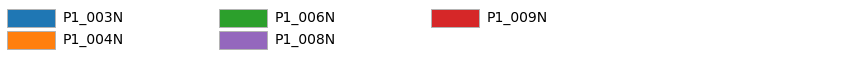

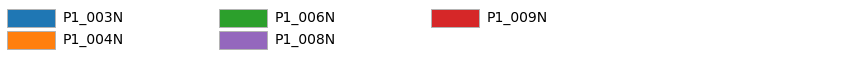

In [ ]:
plot_colortable(colors, sort_colors= True)

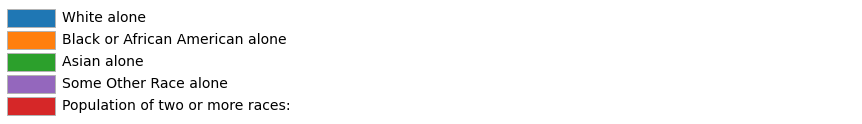

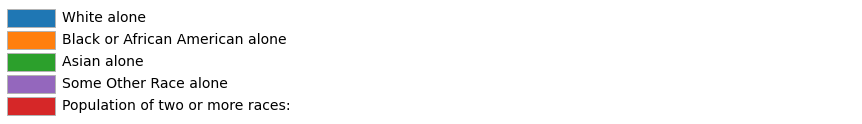

In [ ]:
from collections import OrderedDict
colors = OrderedDict(sorted(colors.items()))
attributes_legend=dict(zip([attributes_series[i] for i in colors.keys()], colors.values()))
plot_colortable(attributes_legend,ncols=1, sort_colors= False)

In [ ]:
colors

OrderedDict([('P1_003N',
              (0.12156862745098039, 0.4666666666666667, 0.7058823529411765)),
             ('P1_004N', (1.0, 0.4980392156862745, 0.054901960784313725)),
             ('P1_006N',
              (0.17254901960784313, 0.6274509803921569, 0.17254901960784313)),
             ('P1_008N',
              (0.5803921568627451, 0.403921568627451, 0.7411764705882353)),
             ('P1_009N',
              (0.8392156862745098, 0.15294117647058825, 0.1568627450980392))])

In [ ]:
neighbors_df['full_race_name'] = neighbors_df['race'].apply(lambda x: attributes_series[x])

In [ ]:
list(sns.color_palette())

[(0.12156862745098039, 0.4666666666666667, 0.7058823529411765),
 (1.0, 0.4980392156862745, 0.054901960784313725),
 (0.17254901960784313, 0.6274509803921569, 0.17254901960784313),
 (0.8392156862745098, 0.15294117647058825, 0.1568627450980392),
 (0.5803921568627451, 0.403921568627451, 0.7411764705882353),
 (0.5490196078431373, 0.33725490196078434, 0.29411764705882354),
 (0.8901960784313725, 0.4666666666666667, 0.7607843137254902),
 (0.4980392156862745, 0.4980392156862745, 0.4980392156862745),
 (0.7372549019607844, 0.7411764705882353, 0.13333333333333333),
 (0.09019607843137255, 0.7450980392156863, 0.8117647058823529)]

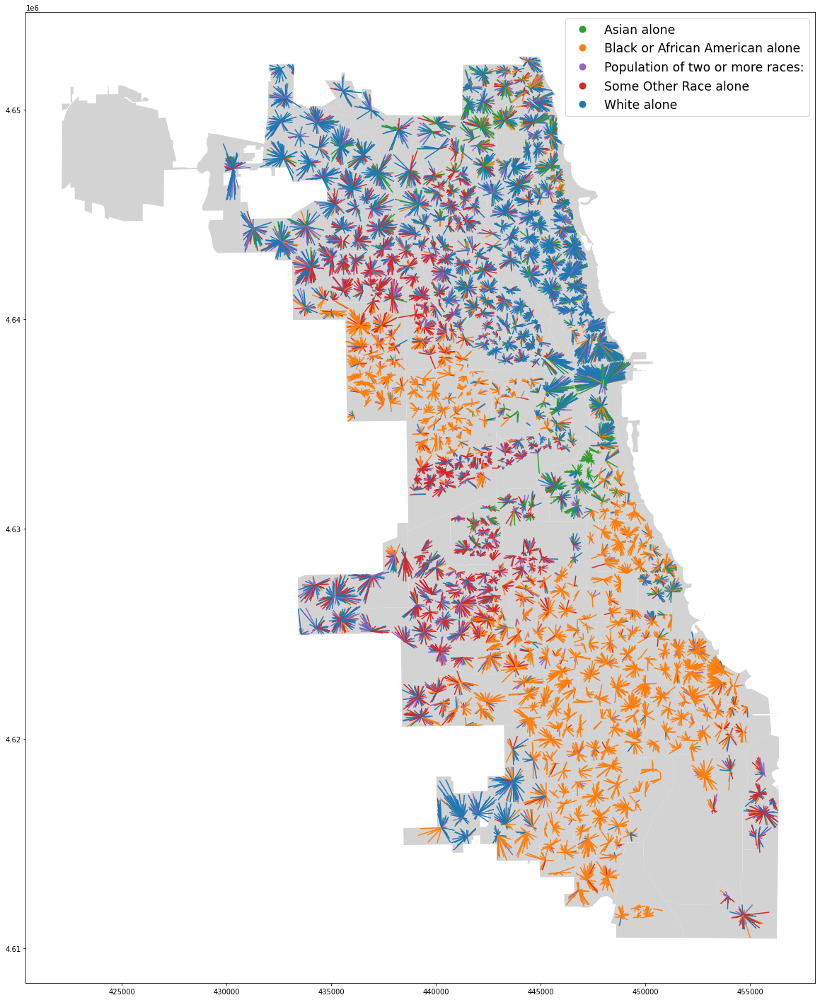

In [ ]:
import matplotlib.pyplot as plt
import matplotlib

fig, ax = plt.subplots(figsize = (20,40))
boundary.plot(ax=ax, color='lightgrey')
my_cmap = matplotlib.colors.ListedColormap([
    
 (0.17254901960784313, 0.6274509803921569, 0.17254901960784313),
 (1.0, 0.4980392156862745, 0.054901960784313725),
 (0.5803921568627451, 0.403921568627451, 0.7411764705882353),
 (0.8392156862745098, 0.15294117647058825, 0.1568627450980392),
(0.12156862745098039, 0.4666666666666667, 0.7058823529411765),


], name='my_colormap')

neighbors_df.sample(20000, random_state=6).plot(column='full_race_name', ax=ax, legend=True, legend_kwds={"fontsize": "xx-large"}, categorical=True, cmap=my_cmap)

In [ ]:
fig.savefig("./Results/map_schools.png")

In [ ]:
import folium
import matplotlib
import shapely
  
test_map = folium.Map([42.019537,-87.669563], zoom_start=15)
for index, row in neighbors_df.sample(n = 30000).to_crs("EPSG:4326")[["geometry","race"]].iterrows():
    folium.PolyLine(shapely.ops.transform(lambda x, y: (y, x), row.geometry).coords, color=matplotlib.colors.to_hex(colors[row.race])).add_to(test_map)

In [ ]:
test_map

In [ ]:
test_map.save('./interactiveplot_school.html')

### Find mean distance nearest neighbors from group A to group B by race


In [ ]:
results_10mil = mean_distance_by_char_A_geopandas(Chicago_df, divvy_df_geo, Chicago_df["race"])

In [ ]:
results_10mil

{'P1_003N': 809.236436505451,
 'P1_004N': 435.33662664029475,
 'P1_006N': 529.8440018290006,
 'P1_024N': 613.1534419393521,
 'P1_008N': 596.6759712425608,
 'P1_012N': 746.1351536067366,
 'P1_005N': 629.5669433591556,
 'P1_019N': 482.0938531221003,
 'P1_013N': 654.2777719898043,
 'P1_022N': 627.1708698273525,
 'P1_011N': 510.71073473776505,
 'P1_015N': 742.9068073595515,
 'P1_027N': 479.4211002665263,
 'P1_007N': 483.9973176879503,
 'P1_017N': 481.57453408747875,
 'P1_063N': 441.7253347144793,
 'P1_065N': 325.370204195648,
 'P1_050N': 589.3248959687155,
 'P1_031N': 788.0513161666747,
 'P1_030N': 543.3229927307867,
 'P1_033N': 705.849069261487,
 'P1_014N': 585.4712834211257,
 'P1_016N': 446.8294332467534,
 'P1_035N': 832.6215806591595,
 'P1_025N': 515.007401737577,
 'P1_021N': 631.4633145238429,
 'P1_037N': 415.4826929524634,
 'P1_023N': 610.5552768604425,
 'P1_018N': 658.5701807829663,
 'P1_034N': 619.2489356472856,
 'P1_057N': 416.41736868527005,
 'P1_020N': 752.376372489349,
 'P1_039N

In [ ]:
newdf = pd.Series(results_10mil)

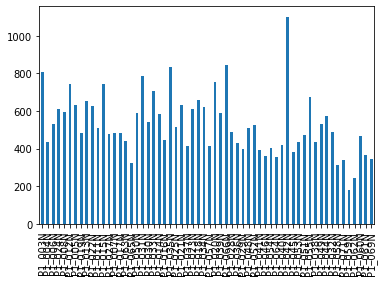

In [ ]:
newdf.plot.bar()

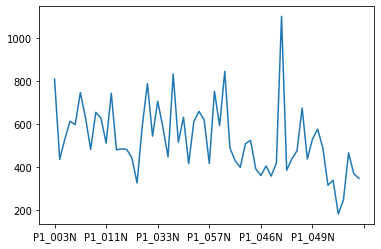

In [ ]:
newdf.plot()

# Testing total datasets

## Import all synthetic dataset

In [ ]:
import os
synthetic_datasets_list = [
 'IL_dataset_50thousand.csv',
 'IL_dataset_200thousand.csv',
 'IL_dataset_500thousand.csv',
 'IL_dataset_1mil.csv',
 'IL_dataset_5mil.csv',
 'IL_dataset_10mil.csv']


In [ ]:
synthetic_dataset_geo = {}
for dataset_name in synthetic_datasets_list:
    synthetic_dataset = merge_dataset(pd.read_csv("./Synthetic Dataset/" + dataset_name))
    synthetic_dataset = merge_dataset(synthetic_dataset, list_grouped=['P1_009N', 'P1_008N'])
    synthetic_dataset = gpd.GeoDataFrame(synthetic_dataset[["FIPS","race"]], geometry=gpd.points_from_xy(synthetic_dataset.lon, synthetic_dataset.lat)).set_crs('epsg:4326').to_crs('epsg:26916')
    synthetic_dataset_geo[dataset_name] = gpd.sjoin(synthetic_dataset, boundary, how="inner", op='intersects').drop(columns=["shape_area", "shape_len", "index_right"]).reset_index(drop=True)


/usr/local/lib/python3.8/dist-packages/IPython/core/interactiveshell.py:3249: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  if (await self.run_code(code, result,  async_=asy)):
/usr/local/lib/python3.8/dist-packages/IPython/core/interactiveshell.py:3249: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  if (await self.run_code(code, result,  async_=asy)):
/usr/local/lib/python3.8/dist-packages/IPython/core/interactiveshell.py:3249: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  if (await self.run_code(code, result,  async_=asy)):
/usr/local/lib/python3.8/dist-packages/IPython/core/interactiveshell.py:3249: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` pa

In [ ]:
del synthetic_dataset

In [ ]:
synthetic_dataset_geo

{'IL_dataset_50thousand.csv':                   FIPS     race                        geometry    pri_neigh  \
 0      170310101002001  P1_004N  POINT (444173.846 4652502.686)  Rogers Park   
 1      170310101002006  P1_004N  POINT (444292.971 4652479.162)  Rogers Park   
 2      170310101002009  P1_003N  POINT (444316.125 4652330.025)  Rogers Park   
 3      170310101002011  P1_004N  POINT (444552.361 4652230.593)  Rogers Park   
 4      170310101002011  P1_004N  POINT (444562.061 4652321.784)  Rogers Park   
 ...                ...      ...                             ...          ...   
 10791  170318411004011  P1_006N  POINT (447143.593 4633506.271)    Chinatown   
 10792  170318411004011  P1_006N  POINT (447243.301 4633518.566)    Chinatown   
 10793  170318411004011  P1_006N  POINT (447230.570 4633456.008)    Chinatown   
 10794  170318411004012  P1_006N  POINT (447534.692 4633491.733)    Chinatown   
 10795  170318411004013  P1_006N  POINT (447366.417 4633456.069)    Chinatown   

(10796, 5)
(43204, 5)
(107276, 5)
(213724, 5)
(1071941, 5)
(2745121, 5)


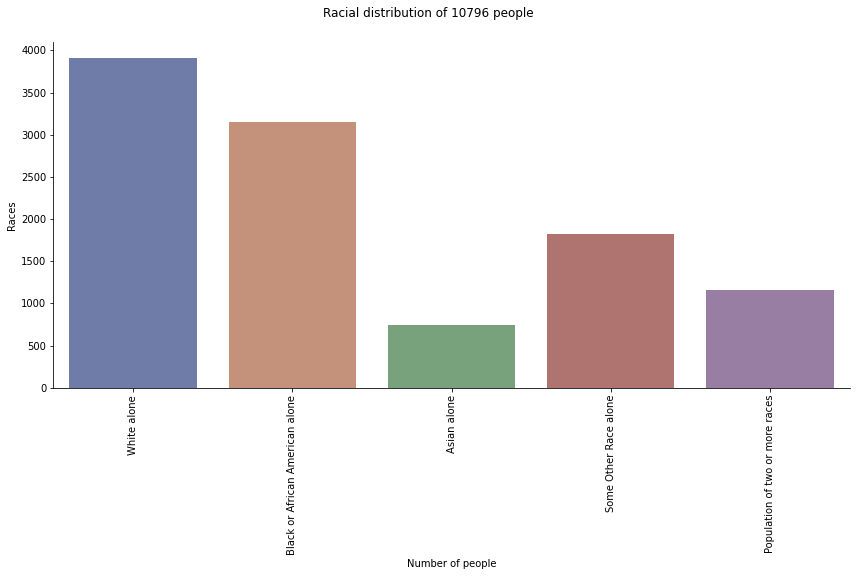

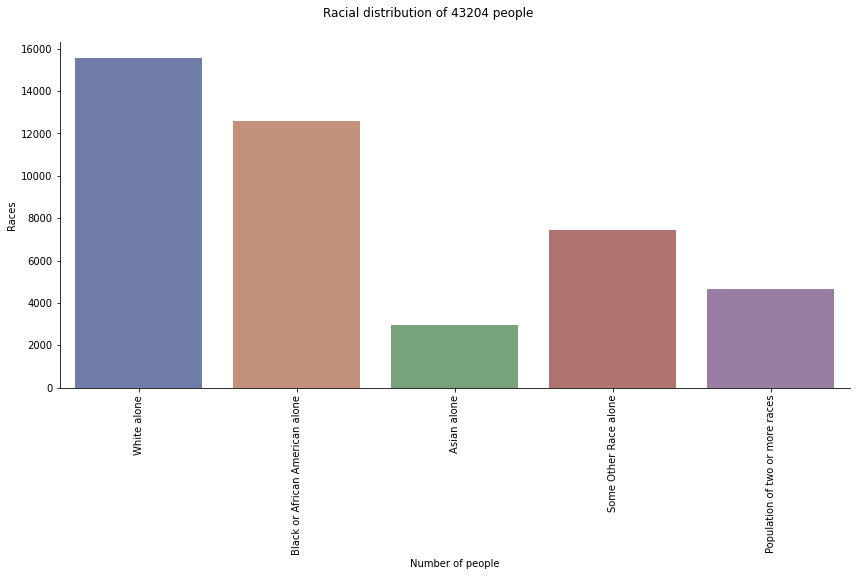

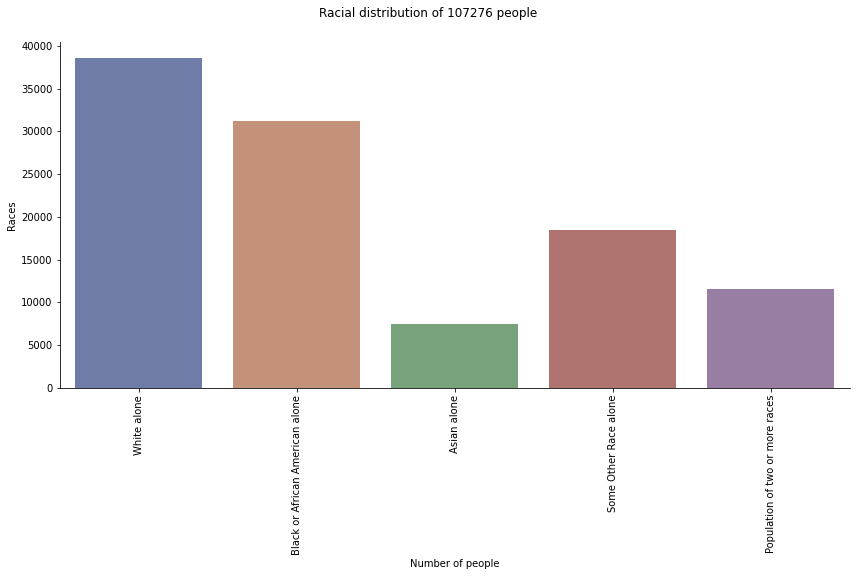

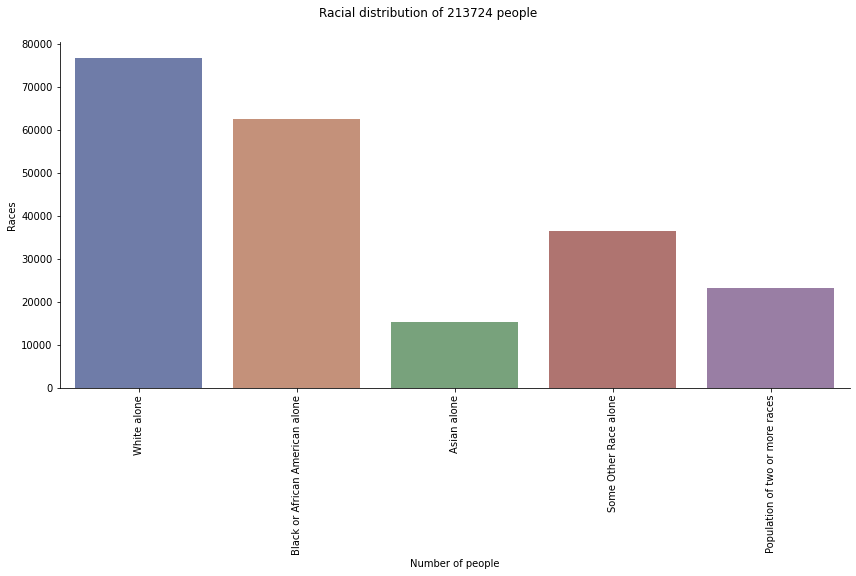

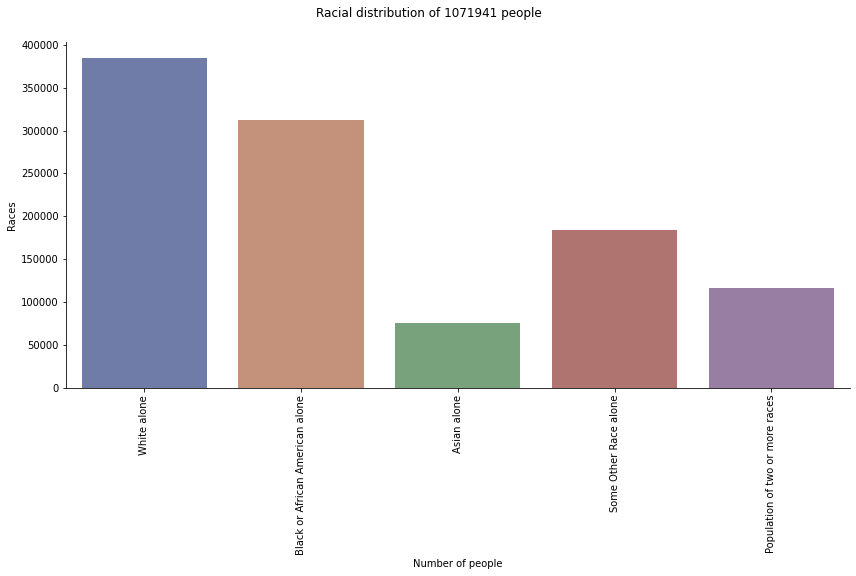

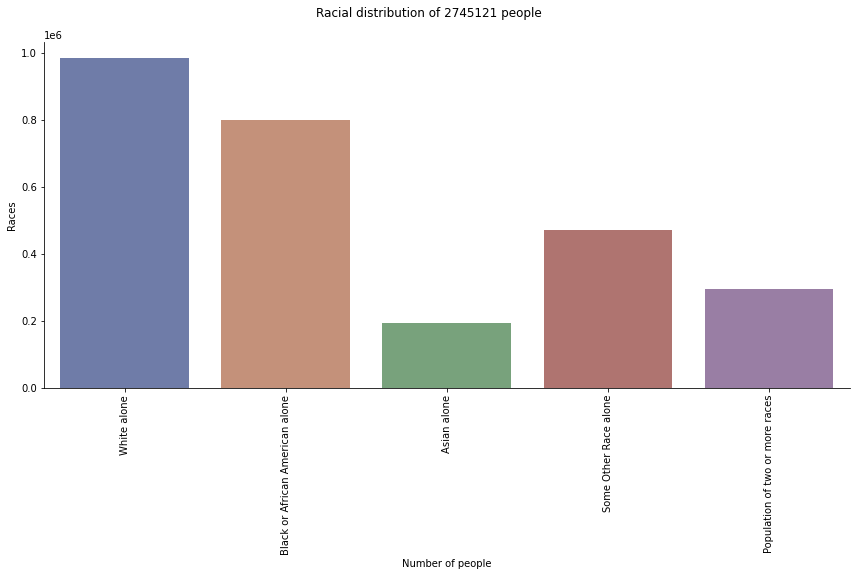

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

plt.rcParams["figure.figsize"] = (10,3)
for dataset in synthetic_dataset_geo.values():
    g = sns.catplot(
      data=dataset,x='race', kind='count', palette="dark", alpha=.6, height=6, aspect=2, order=sorted(dataset.race.value_counts().index)
    )

    g.set_axis_labels("Number of people", "Races")
    g.fig.subplots_adjust(top=0.9)
    g.fig.suptitle('Racial distribution of '+str(dataset.shape[0])+ " people")

    g.set_xticklabels(labels = ['White alone',
                                'Black or African American alone',
                                'Asian alone',
                                'Some Other Race alone',
                                'Population of two or more races'], rotation = 90)
    g.savefig("./Results/population_distribution_" + str(dataset.shape[0]) + ".png")
    print(dataset.shape)

In [ ]:
def calculate_mean_distances(test_dataset, boundary = None, anova_path= ""):
    results = {}
    for dataset_name in synthetic_datasets_list:
        if boundary is None:
            results[dataset_name] = mean_distance_by_char_A_geopandas(synthetic_dataset_geo[dataset_name], test_dataset, synthetic_dataset_geo[dataset_name]["race"], anova_path = anova_path+dataset_name)
        else:
            left_df = synthetic_dataset_geo[dataset_name].loc[synthetic_dataset_geo[dataset_name].within(boundary)].copy()
            right_df = test_dataset.loc[test_dataset.within(boundary)].copy()
            results[dataset_name] = mean_distance_by_char_A_geopandas(left_df, right_df, left_df["race"], anova_path =  anova_path+dataset_name)
    results = pd.DataFrame.from_dict(results)
    return results
        

## Divvy dataset

In [ ]:
test_results = calculate_mean_distances(divvy_df_geo, anova_path = "./Results/divvy_")

In [ ]:
test_results = test_results.sort_index()
test_results

In [ ]:
# importing product
from itertools import product
  
# apply product method
test_results_merge = pd.DataFrame(list(product(test_results.columns,test_results.index)), columns=['dataset', 'race'])
test_results_merge['average_distance'] = test_results_merge.apply(lambda row: test_results.loc[row['race'], row['dataset']], axis=1)
test_results_merge

,dataset,race,average_distance
0,IL_dataset_50thousand.csv,P1_003N,612.417030
1,IL_dataset_50thousand.csv,P1_004N,331.236142
2,IL_dataset_50thousand.csv,P1_006N,423.085269
3,IL_dataset_50thousand.csv,P1_008N,445.672966
4,IL_dataset_50thousand.csv,P1_009N,523.724137
5,IL_dataset_200thousand.csv,P1_003N,604.580211
6,IL_dataset_200thousand.csv,P1_004N,321.677138
7,IL_dataset_200thousand.csv,P1_006N,403.722258
8,IL_dataset_200thousand.csv,P1_008N,448.195841
9,IL_dataset_200thousand.csv,P1_009N,495.319340


In [ ]:
from pathlib import Path  
filepath = Path('./Results/Divvy_results_merged_2.csv')  
filepath.parent.mkdir(parents=True, exist_ok=True) 
test_results.to_csv(filepath)

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
plt.rcParams['figure.figsize']=70,10

In [ ]:
attributes_series = {'P1_003N':'White',
                     'P1_004N':'Black',
                     'P1_006N':'Asian',
                    'P1_008N': 'Other Races',
                   'P1_009N':'Mixed Races'}

In [ ]:
test_results_merge["race_full_names"] = test_results_merge.apply(lambda x: attributes_series[x["race"]], axis = 1)

['//', '//', '//', '//', '//', '//', '..', '..', '..', '..', '..', '..', 'xx', 'xx', 'xx', 'xx', 'xx', 'xx', '/', '/', '/', '/', '/', '/', '*', '*', '*', '*', '*', '*']


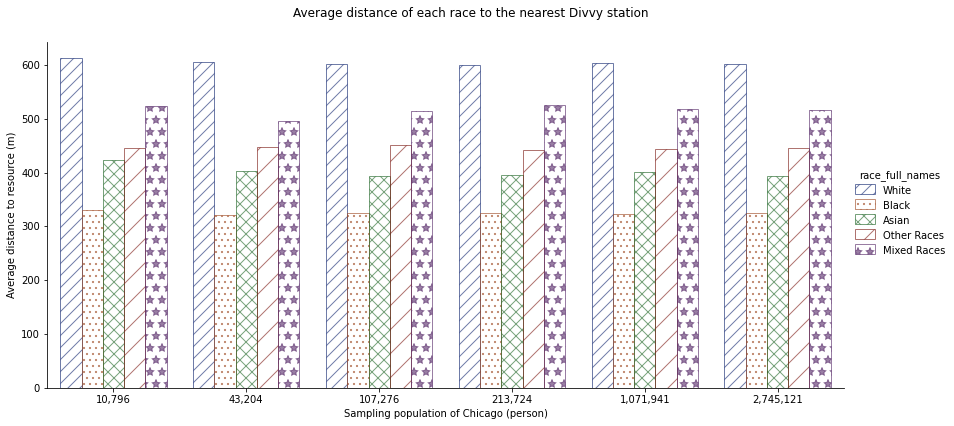

In [ ]:
g = sns.catplot(
    data=test_results_merge, kind="bar",
    x="dataset", y="average_distance", hue="race_full_names", palette="dark", alpha=.6, height=6, aspect=2
)

g.set_axis_labels("Sampling population of Chicago (person)", "Average distance to resource (m)")
g.fig.subplots_adjust(top=0.9)
g.fig.suptitle('Average distance of each race to the nearest Divvy station')

g.set_xticklabels(labels = ["10,796", "43,204", "107,276", "213,724", "1,071,941", "2,745,121"])

# hatches must equal the number of hues (3 in this case)
hatches = ['//', '..', 'xx', '/','*']
h = [val for val in hatches for _ in range((len(g.axes.flat[0].patches) // len(hatches)))] 
print(h)
# iterate through each subplot / Facet
for i, rect in enumerate(g.axes.flat[0].patches):
    rect.set_hatch(h[i])
    fc = rect.get_facecolor()
    rect.set_edgecolor(fc)
    rect.set_facecolor('none')

for lp, hatch in zip(g.legend.get_patches(), hatches):
    lp.set_hatch(hatch)
    lp.set_height(10)
    fc = lp.get_facecolor()
    lp.set_edgecolor(fc)
    lp.set_facecolor('none')
g.savefig("./Results/divvy_biases_merged.png")

In [ ]:
#@title
g = sns.catplot(
    data=test_results_merge[test_results_merge['race'].isin(["P1_003N","P1_004N","P1_005N","P1_006N","P1_007N","P1_008N"])], kind="bar",
    x="race", y="average_distance", hue="dataset", palette="dark", alpha=.6, height=6, aspect=2
)

g.set_axis_labels("Race attributes", "Average distance to resource (m)")
g.fig.subplots_adjust(top=0.9)
g.fig.suptitle('Average distance of each race to the nearest Divvy station')
g.set_xticklabels(labels = test_results.index, rotation=90)
g.savefig("./Results/divvy_biases_one_race_merged.png")

In [ ]:
#@title
g = sns.catplot(
    data=test_results_merge[test_results_merge['race'].isin(["P1_0"+'{:2}'.format(i)+ "N" for i in range(11,26) ])], kind="bar",
    x="race", y="average_distance", hue="dataset", palette="dark", alpha=.6, height=6, aspect=2
)

g.set_axis_labels("Race attributes", "Average distance to resource (m)")
g.fig.subplots_adjust(top=0.9)
g.fig.suptitle('Average distance of each race to the nearest Divvy station')
g.set_xticklabels(labels = test_results.index, rotation=90)
g.savefig("./Results/divvy_biases_two_race_merged.png")

## L stops dataset

In [ ]:
L_train_df_geo

,STOP_ID,DIRECTION_ID,STOP_NAME,STATION_NAME,STATION_DESCRIPTIVE_NAME,geometry
0,30082,E,Cicero (Loop-bound),Cicero,Cicero (Pink Line),POINT (438129.851 4633592.688)
1,30151,E,Central Park (Loop-bound),Central Park,Central Park (Pink Line),POINT (440663.031 4633795.329)
2,30184,W,Halsted/63rd (Ashland-bound),Halsted,Halsted (Green Line),POINT (446460.853 4625433.543)
3,30044,N,Cumberland (O'Hare-bound),Cumberland,Cumberland (Blue Line),POINT (430579.133 4648366.696)
4,30092,E,Racine (O'Hare-bound),Racine,Racine (Blue Line),POINT (445279.153 4636210.128)
...,...,...,...,...,...,...
295,30009,W,Cicero (Harlem-bound),Cicero,Cicero (Green Line),POINT (438216.233 4637444.767)
296,30259,N,Montrose (O'Hare-bound),Montrose,Montrose (Blue Line),POINT (438381.715 4645773.309)
297,30125,N,North/Clybourn (Howard-bound),North/Clybourn,North/Clybourn (Red Line),POINT (446161.438 4640060.167)
298,30172,S,O'Hare (Forest Pk-bound),O'Hare,O'Hare (Blue Line),POINT (425087.882 4647691.811)


In [ ]:
synthetic_dataset_geo['IL_dataset_10mil.csv']

,FIPS,race,geometry,pri_neigh,sec_neigh
0,170310101001000,P1_003N,POINT (444779.716 4652467.780),Rogers Park,ROGERS PARK
1,170310101001000,P1_003N,POINT (444811.297 4652533.761),Rogers Park,ROGERS PARK
2,170310101001000,P1_003N,POINT (444645.640 4652542.501),Rogers Park,ROGERS PARK
3,170310101001000,P1_003N,POINT (444737.459 4652514.861),Rogers Park,ROGERS PARK
4,170310101001000,P1_003N,POINT (444831.268 4652512.753),Rogers Park,ROGERS PARK
...,...,...,...,...,...
2745116,170318390004006,P1_009N,POINT (447869.192 4635872.693),Printers Row,PRINTERS ROW
2745117,170318390004006,P1_009N,POINT (447855.639 4635871.858),Printers Row,PRINTERS ROW
2745118,170318390004006,P1_006N,POINT (447862.304 4635791.194),Printers Row,PRINTERS ROW
2745119,170318390004006,P1_006N,POINT (447852.006 4635878.230),Printers Row,PRINTERS ROW


In [ ]:
L_train_df_geo

,STOP_ID,DIRECTION_ID,STOP_NAME,STATION_NAME,STATION_DESCRIPTIVE_NAME,geometry
0,30082,E,Cicero (Loop-bound),Cicero,Cicero (Pink Line),POINT (438129.851 4633592.688)
1,30151,E,Central Park (Loop-bound),Central Park,Central Park (Pink Line),POINT (440663.031 4633795.329)
2,30184,W,Halsted/63rd (Ashland-bound),Halsted,Halsted (Green Line),POINT (446460.853 4625433.543)
3,30044,N,Cumberland (O'Hare-bound),Cumberland,Cumberland (Blue Line),POINT (430579.133 4648366.696)
4,30092,E,Racine (O'Hare-bound),Racine,Racine (Blue Line),POINT (445279.153 4636210.128)
...,...,...,...,...,...,...
295,30009,W,Cicero (Harlem-bound),Cicero,Cicero (Green Line),POINT (438216.233 4637444.767)
296,30259,N,Montrose (O'Hare-bound),Montrose,Montrose (Blue Line),POINT (438381.715 4645773.309)
297,30125,N,North/Clybourn (Howard-bound),North/Clybourn,North/Clybourn (Red Line),POINT (446161.438 4640060.167)
298,30172,S,O'Hare (Forest Pk-bound),O'Hare,O'Hare (Blue Line),POINT (425087.882 4647691.811)


In [ ]:
test_results = calculate_mean_distances(L_train_df_geo, anova_path = "./Results/L_stops_mean_anova.csv")

In [ ]:
test_results = test_results.sort_index()
test_results

,IL_dataset_50thousand.csv,IL_dataset_200thousand.csv,IL_dataset_500thousand.csv,IL_dataset_1mil.csv,IL_dataset_5mil.csv,IL_dataset_10mil.csv
P1_003N,1419.862965,1448.410970,1435.413270,1430.891291,1441.259510,1440.763170
P1_004N,1970.004897,1984.686023,1997.390915,1984.305930,1997.616493,1992.609646
P1_006N,1114.791707,1104.580151,1127.512750,1119.251696,1121.057809,1121.323049
P1_008N,1982.499673,2025.320002,1988.699644,1968.170159,1977.998523,1976.004325
P1_009N,1811.543715,1841.621658,1827.904346,1854.275564,1842.624362,1841.250004


In [ ]:
from pathlib import Path  
filepath = Path('./Results/L_train_results_merged_2.csv')  
filepath.parent.mkdir(parents=True, exist_ok=True) 
test_results.to_csv(filepath)

In [ ]:
# importing product
from itertools import product

# apply product method
test_results_merge = pd.DataFrame(list(product(test_results.columns,test_results.index)), columns=['dataset', 'race'])
test_results_merge['average_distance'] = test_results_merge.apply(lambda row: test_results.loc[row['race'], row['dataset']], axis=1)
test_results_merge

,dataset,race,average_distance
0,IL_dataset_50thousand.csv,P1_003N,1419.862965
1,IL_dataset_50thousand.csv,P1_004N,1970.004897
2,IL_dataset_50thousand.csv,P1_006N,1114.791707
3,IL_dataset_50thousand.csv,P1_008N,1982.499673
4,IL_dataset_50thousand.csv,P1_009N,1811.543715
5,IL_dataset_200thousand.csv,P1_003N,1448.410970
6,IL_dataset_200thousand.csv,P1_004N,1984.686023
7,IL_dataset_200thousand.csv,P1_006N,1104.580151
8,IL_dataset_200thousand.csv,P1_008N,2025.320002
9,IL_dataset_200thousand.csv,P1_009N,1841.621658


['//', '//', '//', '//', '//', '//', '..', '..', '..', '..', '..', '..', 'xx', 'xx', 'xx', 'xx', 'xx', 'xx', '/', '/', '/', '/', '/', '/', '*', '*', '*', '*', '*', '*']


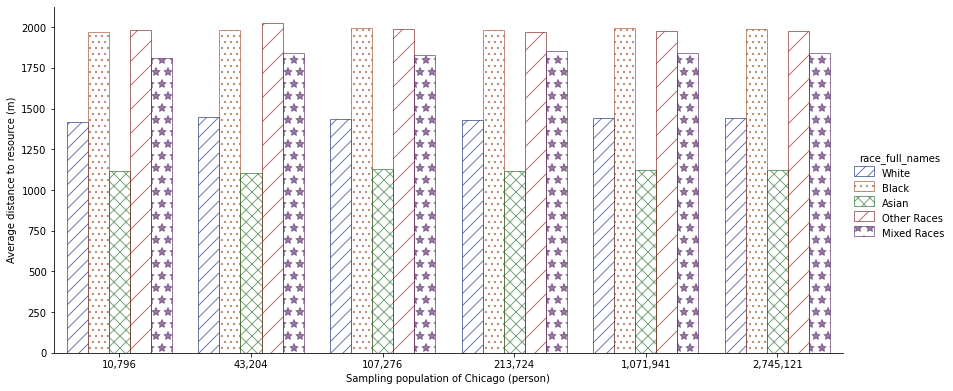

In [ ]:
test_results_merge["race_full_names"] = test_results_merge.apply(lambda x: attributes_series[x["race"]], axis = 1)
g = sns.catplot(
    data=test_results_merge, kind="bar",
    x="dataset", y="average_distance", hue="race_full_names", palette="dark", alpha=.6, height=6, aspect=2
)

g.set_axis_labels("Sampling population of Chicago (person)", "Average distance to resource (m)")
g.fig.subplots_adjust(top=0.9)
# g.fig.suptitle('Average distance of each race to the nearest L train station')

g.set_xticklabels(labels = ["10,796", "43,204", "107,276", "213,724", "1,071,941", "2,745,121"])

# hatches must equal the number of hues (3 in this case)
hatches = ['//', '..', 'xx', '/','*']
h = [val for val in hatches for _ in range((len(g.axes.flat[0].patches) // len(hatches)))] 
print(h)
# iterate through each subplot / Facet
for i, rect in enumerate(g.axes.flat[0].patches):
    rect.set_hatch(h[i])
    fc = rect.get_facecolor()
    rect.set_edgecolor(fc)
    rect.set_facecolor('none')

for lp, hatch in zip(g.legend.get_patches(), hatches):
    lp.set_hatch(hatch)
    fc = lp.get_facecolor()
    lp.set_height(10)
    lp.set_edgecolor(fc)
    lp.set_facecolor('none')
g.savefig("./Results/L_train_biases_merged.png")

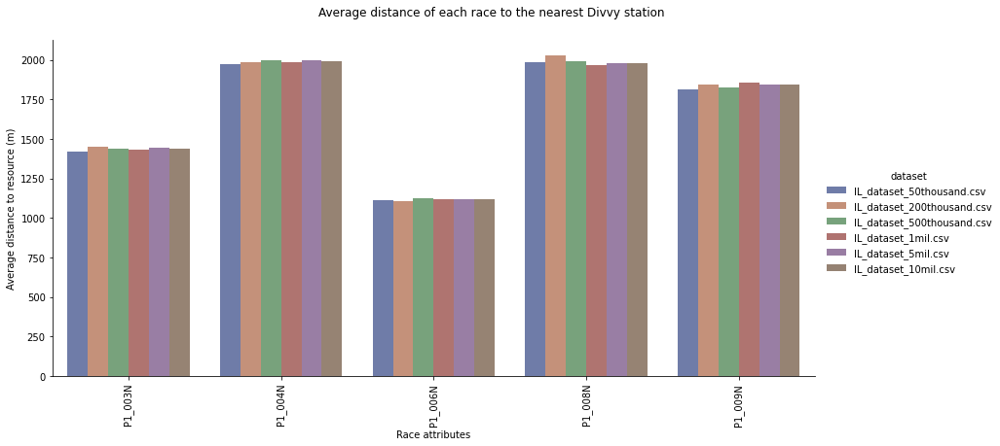

In [ ]:
#@title
g = sns.catplot(
    data=test_results_merge, kind="bar",
    x="race", y="average_distance", hue="dataset", palette="dark", alpha=.6, height=6, aspect=2,
)

g.set_axis_labels("Race attributes", "Average distance to resource (m)")
g.fig.subplots_adjust(top=0.9)
g.fig.suptitle('Average distance of each race to the nearest Divvy station')
g.set_xticklabels(labels = test_results.index, rotation=90)
g.savefig("./Results/L_train_biases_.png") 

In [ ]:
#@title
g = sns.catplot(
    data=test_results_merge, kind="bar",
    x="race", y="average_distance", hue="dataset", palette="dark", alpha=.6, height=6, aspect=2
)

g.set_axis_labels("Race attributes", "Average distance to resource (m)")
g.fig.subplots_adjust(top=0.9)
g.fig.suptitle('Average distance of each race to the nearest Divvy station')
g.set_xticklabels(labels = test_results.index, rotation=90)
g.savefig("./Results/L_train_biases.png") 

In [ ]:
#@title
g = sns.lineplot(data=test_results.loc[["P1_003N","P1_004N","P1_005N","P1_006N","P1_007N","P1_008N"]])
g.set_xticklabels(labels = ["P1_003N","P1_004N","P1_005N","P1_006N","P1_007N","P1_008N"], rotation=90)
fig = g.get_figure()
fig.savefig("./Results/L_train_biases_one_race.png")

In [ ]:
#@title
g = sns.lineplot(data=test_results.loc[["P1_0"+'{:2}'.format(i)+ "N" for i in range(11,26) ]])
g.set_xticklabels(labels = ["P1_0"+'{:2}'.format(i)+ "N" for i in range(11,26) ], rotation=90)
fig = g.get_figure()
fig.savefig("./Results/L_train_biases_two_race.png")

## Bus stop dataset

In [ ]:
test_results = calculate_mean_distances(bus_df_geo, anova_path = "./Results/bus_mean_anova.csv")

In [ ]:
test_results = test_results.sort_index()
test_results

In [ ]:
from pathlib import Path  
filepath = Path('./Results/bus_results_2.csv')  
filepath.parent.mkdir(parents=True, exist_ok=True) 
test_results.to_csv(filepath)

In [ ]:
# importing product
from itertools import product
  
# apply product method
test_results_merge = pd.DataFrame(list(product(test_results.columns,test_results.index)), columns=['dataset', 'race'])
test_results_merge['average_distance'] = test_results_merge.apply(lambda row: test_results.loc[row['race'], row['dataset']], axis=1)
test_results_merge

,dataset,race,average_distance
0,IL_dataset_50thousand.csv,P1_003N,169.127330
1,IL_dataset_50thousand.csv,P1_004N,175.963002
2,IL_dataset_50thousand.csv,P1_006N,143.335544
3,IL_dataset_50thousand.csv,P1_008N,176.786903
4,IL_dataset_50thousand.csv,P1_009N,171.069971
5,IL_dataset_200thousand.csv,P1_003N,168.821003
6,IL_dataset_200thousand.csv,P1_004N,175.345170
7,IL_dataset_200thousand.csv,P1_006N,142.852773
8,IL_dataset_200thousand.csv,P1_008N,177.203639
9,IL_dataset_200thousand.csv,P1_009N,174.498367


['//', '//', '//', '//', '//', '//', '..', '..', '..', '..', '..', '..', 'xx', 'xx', 'xx', 'xx', 'xx', 'xx', '/', '/', '/', '/', '/', '/', '*', '*', '*', '*', '*', '*']


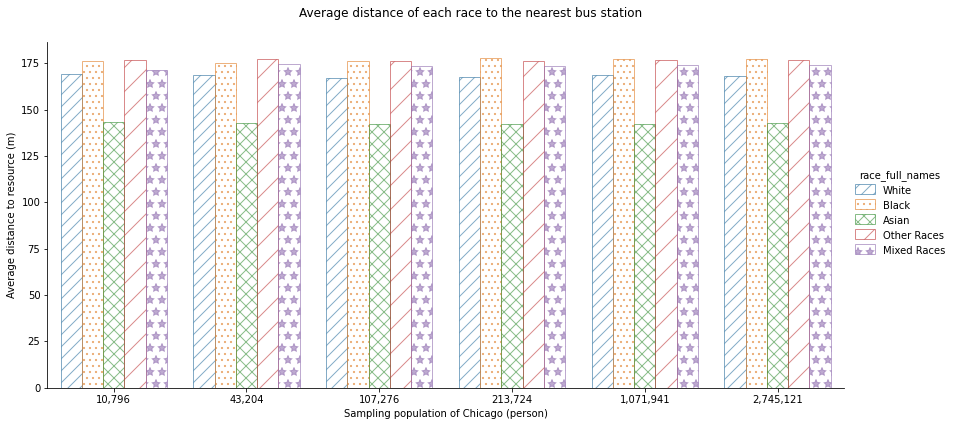

In [ ]:

import matplotlib as mpl
import itertools
test_results_merge["race_full_names"] = test_results_merge.apply(lambda x: attributes_series[x["race"]], axis = 1)
g = sns.catplot(
    data=test_results_merge, kind="bar",
    x="dataset", y="average_distance", hue="race_full_names", alpha=.6, height=6, aspect=2
)

g.set_axis_labels("Sampling population of Chicago (person)", "Average distance to resource (m)")
g.fig.subplots_adjust(top=0.9)
g.fig.suptitle('Average distance of each race to the nearest bus station')
g.set_xticklabels(labels = ["10,796", "43,204", "107,276", "213,724", "1,071,941", "2,745,121"])

# hatches must equal the number of hues (3 in this case)
hatches = ['//', '..', 'xx', '/','*']
h = [val for val in hatches for _ in range((len(g.axes.flat[0].patches) // len(hatches)))] 
print(h)
# iterate through each subplot / Facet
for i, rect in enumerate(g.axes.flat[0].patches):
    rect.set_hatch(h[i])
    fc = rect.get_facecolor()
    rect.set_edgecolor(fc)
    rect.set_facecolor('none')

for lp, hatch in zip(g.legend.get_patches(), hatches):
    lp.set_hatch(hatch)
    fc = lp.get_facecolor()
    lp.set_height(10)
    lp.set_edgecolor(fc)
    lp.set_facecolor('none')
g.savefig("./Results/bus_biases_merged.png")

## Hospitals dataset

In [ ]:
test_results = calculate_mean_distances(hospital_df_geo, anova_path = "./Results/hospital_mean_anova.csv")

In [ ]:
test_results = test_results.sort_index()
test_results

,IL_dataset_50thousand.csv,IL_dataset_200thousand.csv,IL_dataset_500thousand.csv,IL_dataset_1mil.csv,IL_dataset_5mil.csv,IL_dataset_10mil.csv
P1_003N,1727.949891,1742.359858,1724.466465,1723.858937,1728.691141,1728.235479
P1_004N,1630.954565,1632.408065,1635.363656,1637.063374,1637.117903,1636.351999
P1_006N,1605.578542,1656.953420,1633.331427,1641.540654,1642.118397,1642.603613
P1_008N,2173.553469,2168.957985,2174.700047,2171.726180,2172.659001,2170.200964
P1_009N,2002.648374,2026.230182,2026.350390,2059.417261,2042.897451,2040.337047


In [ ]:
from pathlib import Path  
filepath = Path('./Results/hospitals_results_2.csv')  
filepath.parent.mkdir(parents=True, exist_ok=True) 
test_results.to_csv(filepath)

In [ ]:
# importing product
from itertools import product
  
# apply product method
test_results_merge = pd.DataFrame(list(product(test_results.columns,test_results.index)), columns=['dataset', 'race'])
test_results_merge['average_distance'] = test_results_merge.apply(lambda row: test_results.loc[row['race'], row['dataset']], axis=1)
test_results_merge

,dataset,race,average_distance
0,IL_dataset_50thousand.csv,P1_003N,1727.949891
1,IL_dataset_50thousand.csv,P1_004N,1630.954565
2,IL_dataset_50thousand.csv,P1_006N,1605.578542
3,IL_dataset_50thousand.csv,P1_008N,2173.553469
4,IL_dataset_50thousand.csv,P1_009N,2002.648374
5,IL_dataset_200thousand.csv,P1_003N,1742.359858
6,IL_dataset_200thousand.csv,P1_004N,1632.408065
7,IL_dataset_200thousand.csv,P1_006N,1656.953420
8,IL_dataset_200thousand.csv,P1_008N,2168.957985
9,IL_dataset_200thousand.csv,P1_009N,2026.230182


['//', '//', '//', '//', '//', '//', '..', '..', '..', '..', '..', '..', 'xx', 'xx', 'xx', 'xx', 'xx', 'xx', '/', '/', '/', '/', '/', '/', '*', '*', '*', '*', '*', '*']


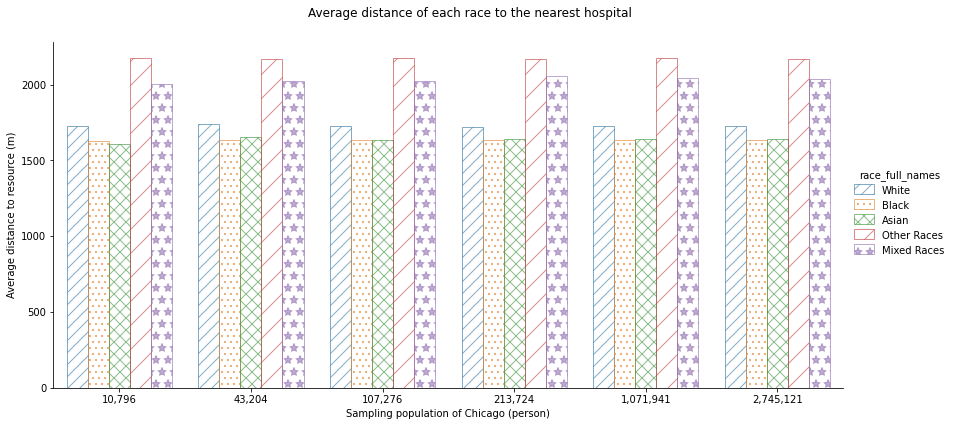

In [ ]:
import seaborn as sns
import matplotlib as mpl
import itertools
test_results_merge["race_full_names"] = test_results_merge.apply(lambda x: attributes_series[x["race"]], axis = 1)
g = sns.catplot(
    data=test_results_merge, kind="bar",
    x="dataset", y="average_distance", hue="race_full_names", alpha=.6, height=6, aspect=2
)

g.set_axis_labels("Sampling population of Chicago (person)", "Average distance to resource (m)")
g.fig.subplots_adjust(top=0.9)
g.fig.suptitle('Average distance of each race to the nearest hospital')
g.set_xticklabels(labels = ["10,796", "43,204", "107,276", "213,724", "1,071,941", "2,745,121"])

# hatches must equal the number of hues (3 in this case)
hatches = ['//', '..', 'xx', '/','*']
h = [val for val in hatches for _ in range((len(g.axes.flat[0].patches) // len(hatches)))] 
print(h)
# iterate through each subplot / Facet
for i, rect in enumerate(g.axes.flat[0].patches):
    rect.set_hatch(h[i])
    fc = rect.get_facecolor()
    rect.set_edgecolor(fc)
    rect.set_facecolor('none')

for lp, hatch in zip(g.legend.get_patches(), hatches):
    lp.set_hatch(hatch)
    fc = lp.get_facecolor()
    lp.set_height(10)
    lp.set_edgecolor(fc)
    lp.set_facecolor('none')
g.savefig("./Results/hospitals_biases_merged.png")

## Schools

In [ ]:
test_results = calculate_mean_distances(schools_df_geo, anova_path = "./Results/school_mean_anova.csv")

In [ ]:
test_results = test_results.sort_index()
test_results

In [ ]:
anova_test = anova_tukey(test_results)
anova_test.to_csv("./Results/schools_mean_anova.csv")
anova_test

In [ ]:
from pathlib import Path  
filepath = Path('./Results/schools_results_2.csv')  
filepath.parent.mkdir(parents=True, exist_ok=True) 
test_results.to_csv(filepath)

In [ ]:
# importing product
from itertools import product
  
# apply product method
test_results_merge = pd.DataFrame(list(product(test_results.columns,test_results.index)), columns=['dataset', 'race'])
test_results_merge['average_distance'] = test_results_merge.apply(lambda row: test_results.loc[row['race'], row['dataset']], axis=1)
test_results_merge

,dataset,race,average_distance
0,IL_dataset_50thousand.csv,P1_003N,451.330884
1,IL_dataset_50thousand.csv,P1_004N,376.136894
2,IL_dataset_50thousand.csv,P1_006N,460.042208
3,IL_dataset_50thousand.csv,P1_008N,364.745332
4,IL_dataset_50thousand.csv,P1_009N,394.419369
5,IL_dataset_200thousand.csv,P1_003N,452.808076
6,IL_dataset_200thousand.csv,P1_004N,374.938880
7,IL_dataset_200thousand.csv,P1_006N,443.231002
8,IL_dataset_200thousand.csv,P1_008N,371.708952
9,IL_dataset_200thousand.csv,P1_009N,396.586792


['//', '//', '//', '//', '//', '//', '..', '..', '..', '..', '..', '..', 'xx', 'xx', 'xx', 'xx', 'xx', 'xx', '/', '/', '/', '/', '/', '/', '*', '*', '*', '*', '*', '*']


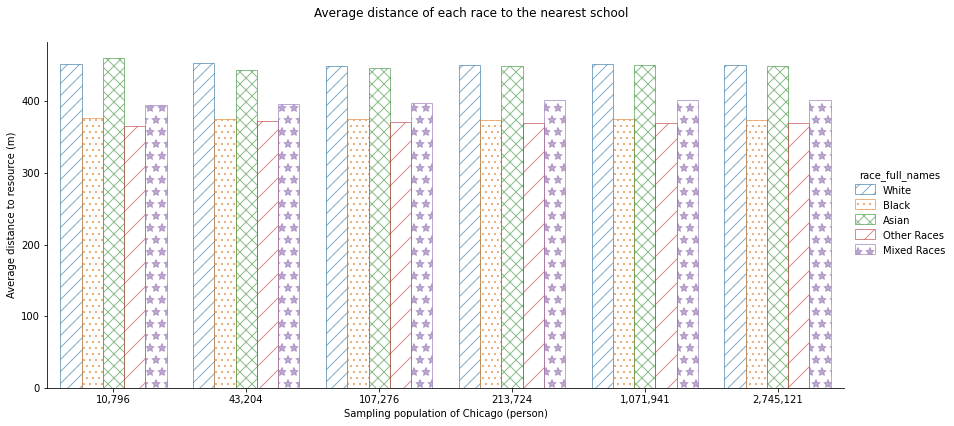

In [ ]:

import matplotlib as mpl
import itertools
test_results_merge["race_full_names"] = test_results_merge.apply(lambda x: attributes_series[x["race"]], axis = 1)
g = sns.catplot(
    data=test_results_merge, kind="bar",
    x="dataset", y="average_distance", hue="race_full_names", alpha=.6, height=6, aspect=2
)

g.set_axis_labels("Sampling population of Chicago (person)", "Average distance to resource (m)")
g.fig.subplots_adjust(top=0.9)
g.fig.suptitle('Average distance of each race to the nearest school')
g.set_xticklabels(labels = ["10,796", "43,204", "107,276", "213,724", "1,071,941", "2,745,121"])

# hatches must equal the number of hues (3 in this case)
hatches = ['//', '..', 'xx', '/','*']
h = [val for val in hatches for _ in range((len(g.axes.flat[0].patches) // len(hatches)))] 
print(h)
# iterate through each subplot / Facet
for i, rect in enumerate(g.axes.flat[0].patches):
    rect.set_hatch(h[i])
    fc = rect.get_facecolor()
    rect.set_edgecolor(fc)
    rect.set_facecolor('none')

for lp, hatch in zip(g.legend.get_patches(), hatches):
    lp.set_hatch(hatch)
    fc = lp.get_facecolor()
    lp.set_height(10)
    lp.set_edgecolor(fc)
    lp.set_facecolor('none')
g.savefig("./Results/school_biases_merged.png")

In [ ]:
#@title
test_results_merge["race_full_names"] = test_results_merge.apply(lambda x: attributes_series[x["race"]], axis = 1)
g = sns.catplot(
    data=test_results_merge[test_results_merge['race'].isin(["P1_003N","P1_004N","P1_005N","P1_006N","P1_007N","P1_008N"])], kind="bar",
    x="race", y="average_distance", hue="dataset", palette="dark", alpha=.6, height=6, aspect=2
)

g.set_axis_labels("Race attributes", "Average distance to resource (m)")
g.fig.subplots_adjust(top=0.9)
g.fig.suptitle('Average distance of each race to the nearest bus station')
g.set_xticklabels(labels = test_results.index, rotation=90)
g.savefig("./Results/bus_biases_one_race.png")

In [ ]:
#@title
g = sns.catplot(
    data=test_results_merge[test_results_merge['race'].isin(["P1_0"+'{:2}'.format(i)+ "N" for i in range(11,26) ])], kind="bar",
    x="race", y="average_distance", hue="dataset", palette="dark", alpha=.6, height=6, aspect=2
)

g.set_axis_labels("Race attributes", "Average distance to resource (m)")
g.fig.subplots_adjust(top=0.9)
g.fig.suptitle('Average distance of each race to the nearest Divvy station')
g.set_xticklabels(labels = test_results.index, rotation=90)
g.savefig("./Results/bus_biases_two_race.png")

In [ ]:
#@title
g = sns.lineplot(data=test_results.loc[["P1_003N","P1_004N","P1_005N","P1_006N","P1_007N","P1_008N"]])
g.set_xticklabels(labels = ["P1_003N","P1_004N","P1_005N","P1_006N","P1_007N","P1_008N"], rotation=90)
fig = g.get_figure()
fig.savefig("./Results/bus_biases_one_race.png")

In [ ]:
#@title
g = sns.lineplot(data=test_results.loc[["P1_0"+'{:2}'.format(i)+ "N" for i in range(11,26) ]])
g.set_xticklabels(labels = ["P1_0"+'{:2}'.format(i)+ "N" for i in range(11,26) ], rotation=90)
fig = g.get_figure()
fig.savefig("./Results/bus_biases_two_race.png")

# Calculate by neighborhoods

In [ ]:
boundary

,pri_neigh,sec_neigh,shape_area,shape_len,geometry
0,Grand Boulevard,BRONZEVILLE,48492503.1554,28196.837157,"MULTIPOLYGON (((-9752334.139 5133578.411, -975..."
1,Printers Row,PRINTERS ROW,2162137.97139,6864.247156,"MULTIPOLYGON (((-9754660.588 5142179.363, -975..."
2,United Center,UNITED CENTER,32520512.7053,23101.363745,"MULTIPOLYGON (((-9759053.446 5144344.508, -975..."
3,Sheffield & DePaul,SHEFFIELD & DEPAUL,10482592.2987,13227.049745,"MULTIPOLYGON (((-9758081.210 5149251.922, -975..."
4,Humboldt Park,HUMBOLDT PARK,125010425.593,46126.751351,"MULTIPOLYGON (((-9767238.432 5144190.682, -976..."
...,...,...,...,...,...
93,Belmont Cragin,"BELMONT CRAGIN,HERMOSA",109099407.211,43311.706886,"MULTIPOLYGON (((-9767331.309 5148552.274, -976..."
94,Austin,AUSTIN,170037750.826,55473.345911,"MULTIPOLYGON (((-9768974.958 5148325.590, -976..."
95,Gold Coast,GOLD COAST,7165705.53467,13685.479377,"MULTIPOLYGON (((-9754532.696 5147727.369, -975..."
96,Boystown,BOYSTOWN,3365778.97115,9780.268985,"MULTIPOLYGON (((-9757018.082 5151994.103, -975..."


In [ ]:

import matplotlib as mpl
import itertools
for i in range(boundary.shape[0]):
    test_results = calculate_mean_distances(bus_df_geo, boundary=boundary.loc[i, 'geometry'])
    test_results_merge["race_full_names"] = test_results_merge.apply(lambda x: attributes_series[x["race"]], axis = 1)
    g = sns.catplot(
        data=test_results_merge, kind="bar",
        x="dataset", y="average_distance", hue="race_full_names", alpha=.6, height=6, aspect=2
    )

    g.set_axis_labels("Race attributes", "Average distance to resource (m)")
    g.fig.subplots_adjust(top=0.9)
    g.fig.suptitle('Average distance of each race to the nearest bus station in ' + boundary.loc[i, 'pri_neigh'])
    g.set_xticklabels(labels = ["10,796", "43,204", "107,276", "213,724", "1,071,941", "2,745,121"])

    # hatches must equal the number of hues (3 in this case)
    hatches = ['//', '..', 'xx', '/','*', '\\', 'o']
    h = [val for val in hatches for _ in range((len(g.axes.flat[0].patches) // len(hatches)))] 
    # iterate through each subplot / Facet
    for i, rect in enumerate(g.axes.flat[0].patches):
        rect.set_hatch(h[i])
        fc = rect.get_facecolor()
        rect.set_edgecolor(fc)
        rect.set_facecolor('none')

    for lp, hatch in zip(g.legend.get_patches(), hatches):
        lp.set_hatch(hatch)
        fc = lp.get_facecolor()
        lp.set_height(10)
        lp.set_edgecolor(fc)
        lp.set_facecolor('none')
    plt.savefig("./Results/bus_biases_merged_"+ boundary.loc[i, 'pri_neigh']+ ".png")
    plt.close(g.fig)

In [ ]:
import matplotlib as mpl
import itertools
for i in range(boundary.shape[0]):
    test_results = calculate_mean_distances(divvy_df_geo, boundary=boundary.loc[i, 'geometry'])
    test_results_merge["race_full_names"] = test_results_merge.apply(lambda x: attributes_series[x["race"]], axis = 1)
    g = sns.catplot(
        data=test_results_merge, kind="bar",
        x="dataset", y="average_distance", hue="race_full_names", alpha=.6, height=6, aspect=2
    )

    g.set_axis_labels("Race attributes", "Average distance to resource (m)")
    g.fig.subplots_adjust(top=0.9)
    g.fig.suptitle('Average distance of each race to the nearest Divvy station in ' + boundary.loc[i, 'pri_neigh'])
    g.set_xticklabels(labels = ["10,796", "43,204", "107,276", "213,724", "1,071,941", "2,745,121"])

    # hatches must equal the number of hues (3 in this case)
    hatches = ['//', '..', 'xx', '/','*', '\\', 'o']
    h = [val for val in hatches for _ in range((len(g.axes.flat[0].patches) // len(hatches)))] 
    # iterate through each subplot / Facet
    for i, rect in enumerate(g.axes.flat[0].patches):
        rect.set_hatch(h[i])
        fc = rect.get_facecolor()
        rect.set_edgecolor(fc)
        rect.set_facecolor('none')

    for lp, hatch in zip(g.legend.get_patches(), hatches):
        lp.set_hatch(hatch)
        fc = lp.get_facecolor()
        lp.set_height(10)
        lp.set_edgecolor(fc)
        lp.set_facecolor('none')
    plt.savefig("./Results/divvy_biases_merged_"+ str(boundary.loc[i, 'pri_neigh'])+ ".png", format="PNG")
    plt.close(g.fig)

In [ ]:
i = 2

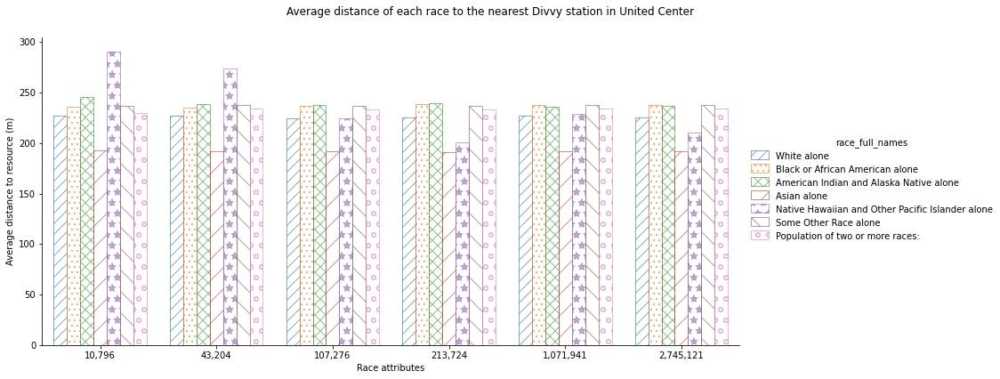

In [ ]:

    test_results = calculate_mean_distances(divvy_df_geo, boundary=boundary.loc[i, 'geometry'])
    test_results_merge["race_full_names"] = test_results_merge.apply(lambda x: attributes_series[x["race"]], axis = 1)
    g = sns.catplot(
        data=test_results_merge, kind="bar",
        x="dataset", y="average_distance", hue="race_full_names", alpha=.6, height=6, aspect=2
    )

    g.set_axis_labels("Race attributes", "Average distance to resource (m)")
    g.fig.subplots_adjust(top=0.9)
    g.fig.suptitle('Average distance of each race to the nearest Divvy station in ' + boundary.loc[i, 'pri_neigh'])
    g.set_xticklabels(labels = ["10,796", "43,204", "107,276", "213,724", "1,071,941", "2,745,121"])

    # hatches must equal the number of hues (3 in this case)
    hatches = ['//', '..', 'xx', '/','*', '\\', 'o']
    h = [val for val in hatches for _ in range((len(g.axes.flat[0].patches) // len(hatches)))] 
    # iterate through each subplot / Facet
    for i, rect in enumerate(g.axes.flat[0].patches):
        rect.set_hatch(h[i])
        fc = rect.get_facecolor()
        rect.set_edgecolor(fc)
        rect.set_facecolor('none')

    for lp, hatch in zip(g.legend.get_patches(), hatches):
        lp.set_hatch(hatch)
        fc = lp.get_facecolor()
        lp.set_height(10)
        lp.set_edgecolor(fc)
        lp.set_facecolor('none')
    g.savefig("/content/drive/MyDrive/Bias Project/Results/divvy_biases_merged_"+ str(boundary.loc[i, 'pri_neigh'])+ ".png", format="PNG")

In [ ]:
boundary.loc[i, 'pri_neigh']

'United Center'

'/content/drive/MyDrive/Bias Project'

'/content/drive/MyDrive/Bias Project'